In [2]:
#Data Analysis
import pandas as pd
import numpy as np
# Modeling
import statsmodels.api as sm
from pygam import GAM, ExpectileGAM, s, f
from sklearn.preprocessing import LabelEncoder
# Visualization
import plotly.express as px
from plotnine import *
import pytimetk as tk
import textwrap 
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

In [3]:
df_event = pd.read_excel('dataset_avec_event.xlsx')

In [13]:
df_event

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,nbre res,paid price,rev par type de chambre,event
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,144,728.13,97643.77,no_promo
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,144,676.01,97643.77,no_promo
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,144,667.57,97643.77,no_promo
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,144,639.01,97643.77,is_promo
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,144,722.32,97643.77,no_promo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,70,1465.57,104947.60,no_promo
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,70,1592.27,104947.60,no_promo
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,70,1468.10,104947.60,is_promo
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,70,1470.13,104947.60,is_promo


In [4]:
df_encoded = pd.read_excel('encoded_data.xlsx')

#### we are going to create a specific model for every period and Booking Lead interval, demand response require the isolation of the variable price. 

# GAMs : Revenue Optimization 
## The Every day price optimization

# Months: 2, 3, 4, 5, 9, 10, 11

## Event: no_promo

### Booking Lead in [0 , 20]

In [95]:
data_filtered = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'no_promo') &
        (df_event['booking lead'] <= 20)
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X1 = data_filtered[['paid price']]
y1= data_filtered['nbre res']

print(len(X1)) 

11453


In [96]:
# Create a list of unique products
unique_products = data_filtered['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [97]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered[data_filtered['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9775,2024-02-01,3,711.12,single,240,160457.66,206.741006,227.480859,259.951502
9776,2024-02-01,12,696.22,single,240,160457.66,222.645908,265.939479,315.015960
9778,2024-02-01,0,714.66,single,240,160457.66,205.139380,223.541960,252.171475
9780,2024-02-01,9,704.80,single,240,160457.66,212.677914,240.965521,277.791471
9791,2024-02-01,20,691.33,single,240,160457.66,240.836069,285.716116,341.581753
...,...,...,...,...,...,...,...,...,...
257405,2025-05-30,4,1493.23,family,184,261424.47,148.861798,174.904824,192.753397
257421,2025-05-30,0,1505.44,family,184,261424.47,136.161540,162.452592,186.688871
257435,2025-05-30,20,1462.82,family,184,261424.47,177.405916,189.803072,197.302340
257463,2025-05-30,19,1464.10,family,184,261424.47,176.296545,189.351711,197.126834


In [98]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1678,51.90,42.51
1,single,0.500,0.6988,31.22,24.88
2,single,0.975,0.1222,53.30,43.78
3,double,0.025,0.1208,39.55,32.41
4,double,0.500,0.6853,23.66,18.80
5,double,0.975,0.0937,40.15,32.92
6,family,0.025,0.1273,26.62,21.82
7,family,0.500,0.6897,15.87,12.64
8,family,0.975,0.1164,26.78,21.91


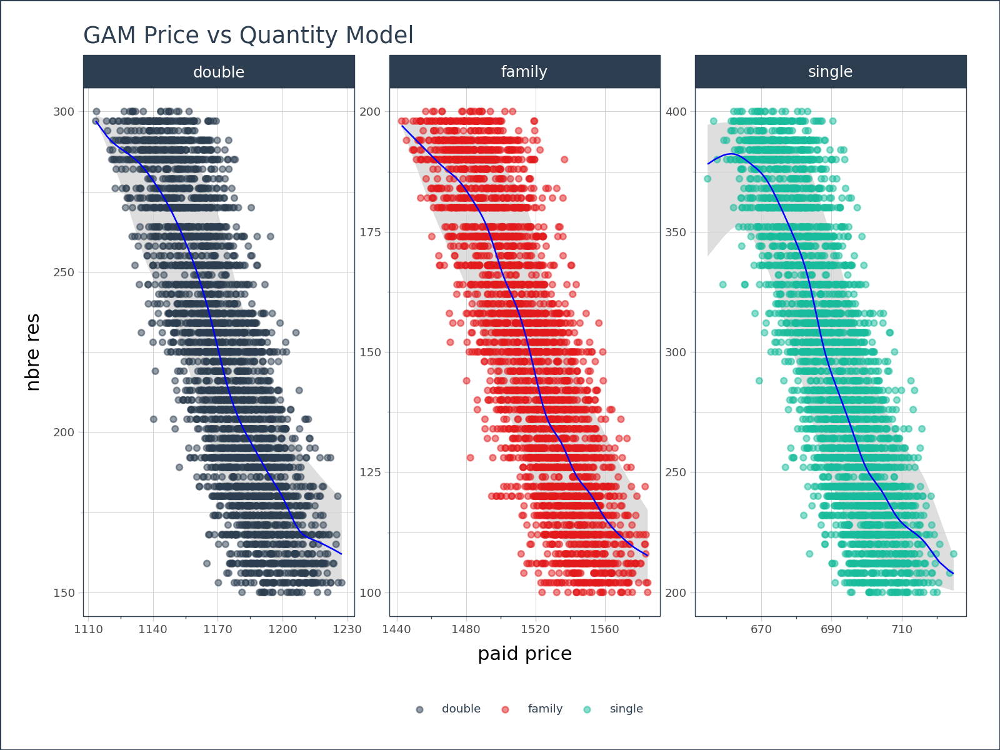

In [99]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)


In [100]:
df_Every_day_pred1 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [101]:
data_filtered2 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X2 = data_filtered2[['paid price']]
y2 = data_filtered2['nbre res']

print(len(X2))


9990


In [102]:
# Create a list of unique products
unique_products = data_filtered2['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered2[data_filtered2['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9779,2024-02-01,35,673.91,single,240,160457.66,246.350308,293.347280,349.117940
9782,2024-02-01,39,683.83,single,240,160457.66,217.410973,253.849970,296.130050
9788,2024-02-01,29,676.79,single,240,160457.66,233.654994,278.180634,331.862860
9809,2024-02-01,37,678.60,single,240,160457.66,227.365388,269.760713,321.658520
9812,2024-02-01,22,690.70,single,240,160457.66,210.125013,233.016252,266.704835
...,...,...,...,...,...,...,...,...,...
257389,2025-05-30,25,1475.50,family,184,261424.47,129.218605,155.424108,182.271991
257406,2025-05-30,35,1432.97,family,184,261424.47,175.420636,189.679109,197.242796
257408,2025-05-30,40,1442.85,family,184,261424.47,164.354973,184.663333,195.284275
257410,2025-05-30,34,1447.03,family,184,261424.47,160.104946,182.115128,194.538341


In [103]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1739,51.39,42.01
1,single,0.500,0.7012,30.91,24.58
2,single,0.975,0.1282,52.80,43.30
3,double,0.025,0.1452,39.50,32.38
4,double,0.500,0.6964,23.54,18.84
5,double,0.975,0.1476,39.44,32.16
6,family,0.025,0.1485,26.04,21.60
7,family,0.500,0.7103,15.19,12.01
8,family,0.975,0.1803,25.55,20.79


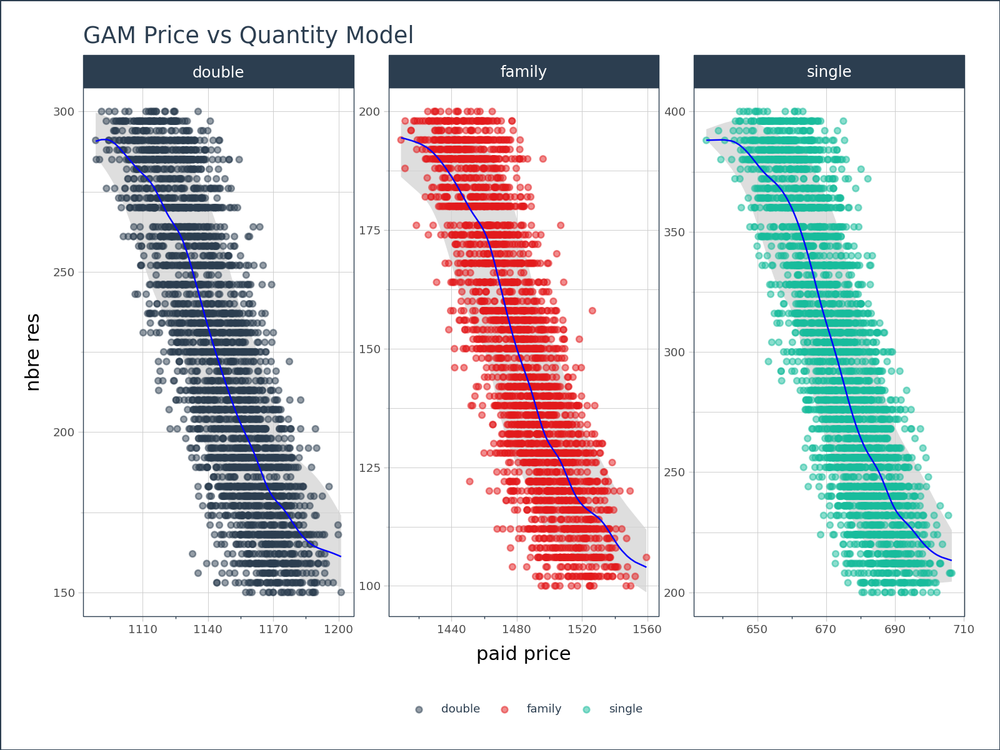

In [104]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [105]:
df_Every_day_pred2 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [106]:
data_filtered3 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X3 = data_filtered3[['paid price']]
y3 = data_filtered3['nbre res']

print(len(X3))


9280


In [107]:
# Create a list of unique products
unique_products = data_filtered3['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered3[data_filtered3['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9792,2024-02-01,59,657.11,single,240,160457.66,246.751389,295.452267,350.688346
9797,2024-02-01,50,670.14,single,240,160457.66,212.784112,245.123147,288.240388
9799,2024-02-01,53,660.10,single,240,160457.66,236.883348,281.954351,336.121097
9815,2024-02-01,60,659.62,single,240,160457.66,238.451356,284.114589,338.621951
9816,2024-02-01,56,658.35,single,240,160457.66,242.562374,289.778000,344.903983
...,...,...,...,...,...,...,...,...,...
257367,2025-05-30,54,1396.93,family,184,261424.47,171.834480,188.502122,197.243656
257393,2025-05-30,48,1424.83,family,184,261424.47,147.735593,172.218771,191.459280
257399,2025-05-30,41,1427.34,family,184,261424.47,145.527818,170.668164,190.923708
257445,2025-05-30,45,1422.34,family,184,261424.47,149.761177,173.953572,191.995609


In [108]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1650,52.04,42.39
1,single,0.500,0.6921,31.61,25.40
2,single,0.975,0.1071,53.82,44.11
3,double,0.025,0.1749,38.31,31.63
4,double,0.500,0.7048,22.92,18.28
5,double,0.975,0.1450,39.00,31.98
6,family,0.025,0.1073,26.88,22.33
7,family,0.500,0.6920,15.79,12.53
8,family,0.975,0.1198,26.69,21.86


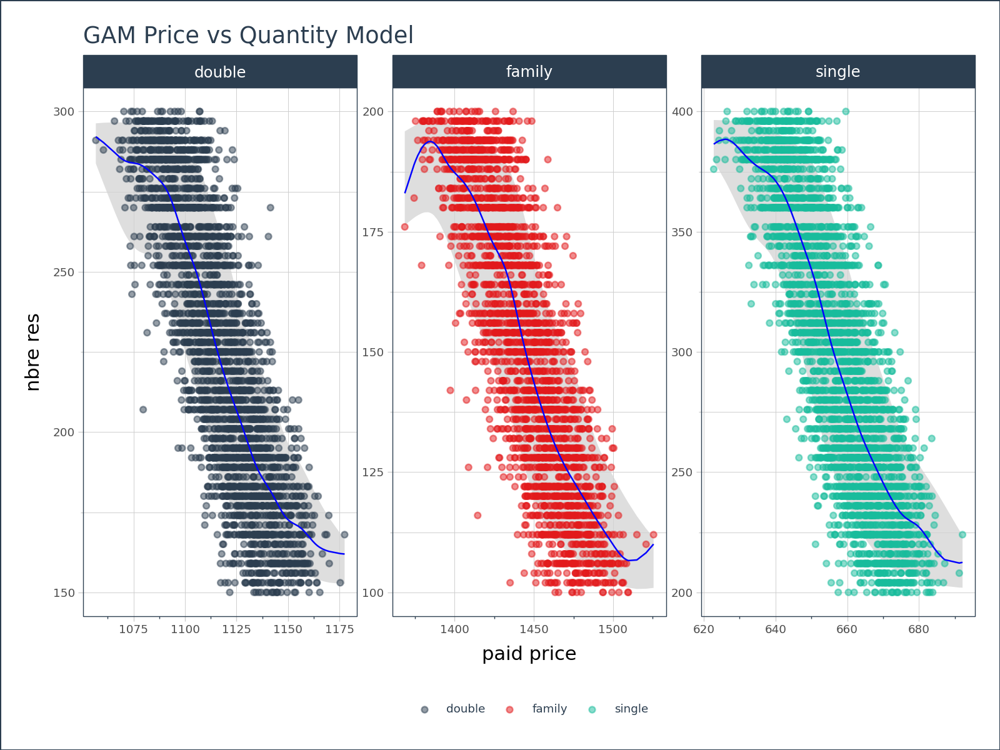

In [109]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [110]:
df_Every_day_pred3 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [111]:
data_filtered4 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X4 = data_filtered4[['paid price']]
y4 = data_filtered4['nbre res']

print(len(X4))


9284


In [112]:
# Create a list of unique products
unique_products = data_filtered4['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered4[data_filtered4['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9777,2024-02-01,69,651.78,single,240,160457.66,217.382922,252.114537,294.660597
9787,2024-02-01,78,654.78,single,240,160457.66,212.895586,243.599772,283.941605
9793,2024-02-01,62,656.88,single,240,160457.66,211.559502,240.134116,277.416749
9806,2024-02-01,74,642.16,single,240,160457.66,245.168659,290.280847,344.186074
9841,2024-02-01,76,650.57,single,240,160457.66,219.394451,255.897794,299.189689
...,...,...,...,...,...,...,...,...,...
257372,2025-05-30,75,1385.25,family,184,261424.47,152.713937,177.319026,193.142057
257416,2025-05-30,74,1392.07,family,184,261424.47,145.298159,170.443089,190.516736
257417,2025-05-30,68,1402.10,family,184,261424.47,133.922221,159.555791,184.818054
257424,2025-05-30,77,1352.27,family,184,261424.47,180.328161,191.694212,197.741853


In [113]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1581,52.13,42.83
1,single,0.500,0.7023,31.00,24.78
2,single,0.975,0.1558,52.20,42.75
3,double,0.025,0.1556,39.11,32.24
4,double,0.500,0.6994,23.34,18.58
5,double,0.975,0.1312,39.68,32.58
6,family,0.025,0.1521,26.16,21.58
7,family,0.500,0.7036,15.47,12.29
8,family,0.975,0.1590,26.06,21.23


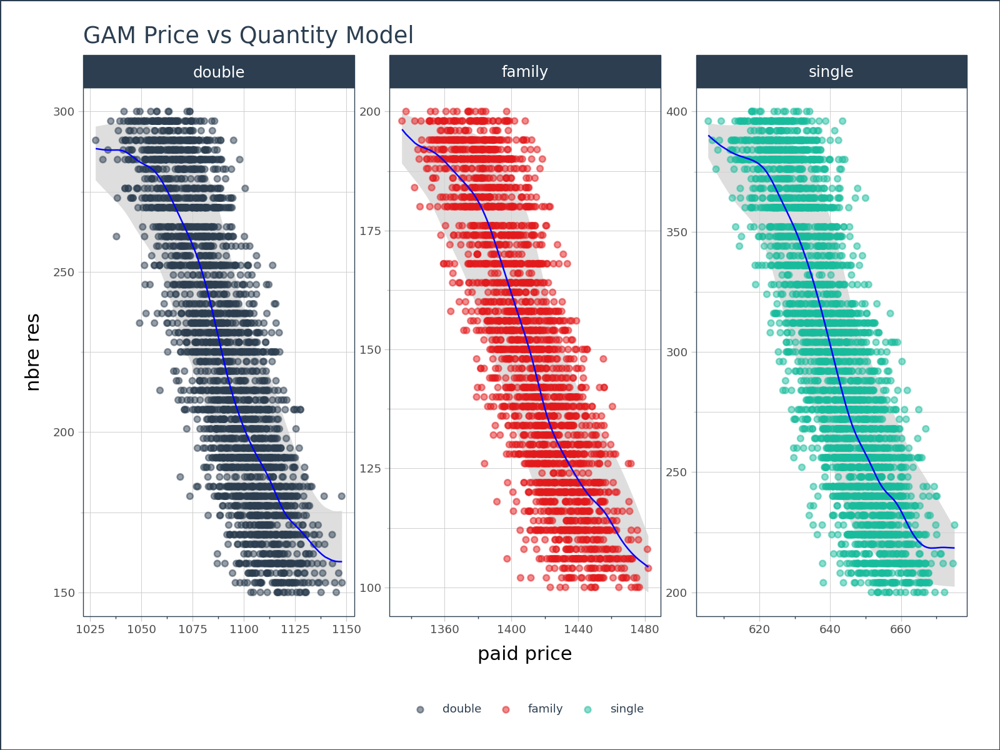

In [114]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [115]:
df_Every_day_pred4 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [116]:
data_filtered5 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X5 = data_filtered5[['paid price']]
y5 = data_filtered5['nbre res']

print(len(X5))


4551


In [117]:
# Create a list of unique products
unique_products = data_filtered5['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered5[data_filtered5['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9783,2024-02-01,86,639.20,single,240,160457.66,215.261578,246.759377,288.143006
9805,2024-02-01,82,642.43,single,240,160457.66,210.851594,239.526639,272.908145
9822,2024-02-01,81,646.60,single,240,160457.66,207.020014,227.729822,254.142484
9827,2024-02-01,87,637.16,single,240,160457.66,221.776654,254.347260,296.593309
9855,2024-02-01,90,637.33,single,240,160457.66,221.107481,253.586032,295.922658
...,...,...,...,...,...,...,...,...,...
256633,2025-05-29,81,1406.04,family,142,207683.11,109.545321,125.307624,144.521103
256649,2025-05-29,90,1386.31,family,142,207683.11,126.078779,145.705514,166.908680
257344,2025-05-30,89,1354.06,family,184,261424.47,164.519454,183.680263,194.405812
257364,2025-05-30,81,1359.53,family,184,261424.47,157.458620,179.590414,193.193791


In [118]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.3813,44.71,37.10
1,single,0.500,0.7846,26.38,20.82
2,single,0.975,0.3734,44.99,37.05
3,double,0.025,0.4095,33.06,27.10
4,double,0.500,0.7905,19.69,15.48
5,double,0.975,0.3767,33.96,28.04
6,family,0.025,0.3715,22.37,18.68
7,family,0.500,0.7872,13.02,10.32
8,family,0.975,0.4022,21.82,17.88


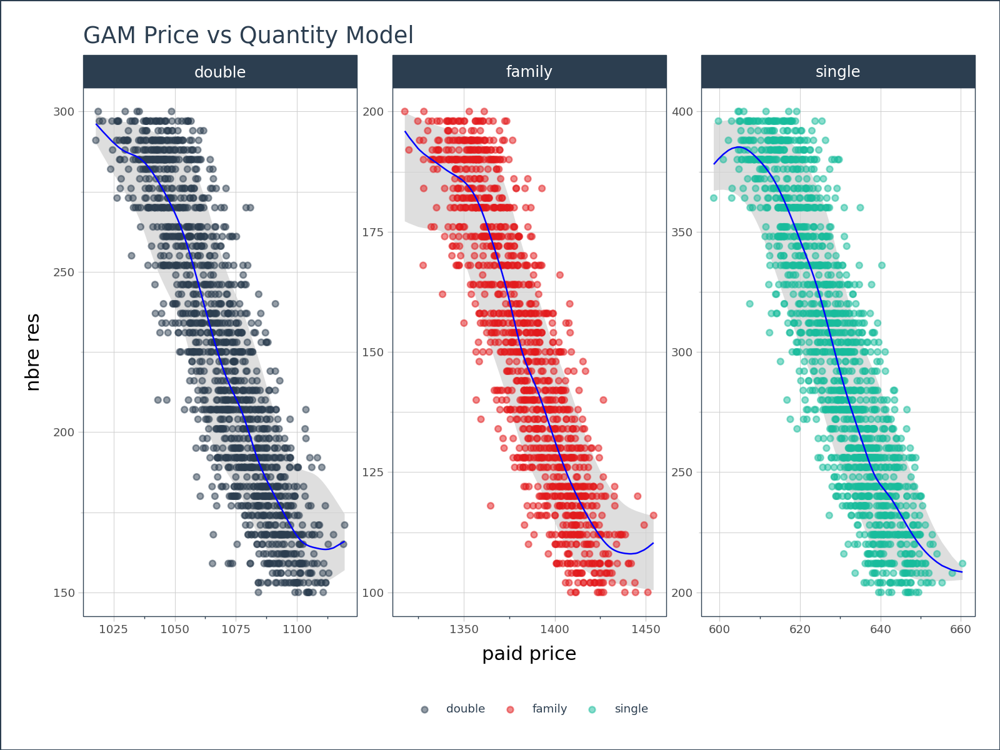

In [119]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [120]:
df_Every_day_pred5 = all_gam_results.copy()

## Event: is_promo

### Booking Lead in [0 , 20]

In [121]:
data_filtered6 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_promo') & 
        ((df_event['booking lead'] >= 0) & (df_event['booking lead'] <= 20))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X6 = data_filtered6[['paid price']]
y6 = data_filtered6['nbre res']

print(len(X6))


2768


In [122]:
# Create a list of unique products
unique_products = data_filtered6['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered6[data_filtered6['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9818,2024-02-01,19,640.44,single,240,160457.66,245.988443,293.606929,344.833110
9850,2024-02-01,13,648.70,single,240,160457.66,214.674101,251.587093,293.600073
10314,2024-02-02,6,615.92,single,396,254636.24,348.036804,376.179606,393.764334
10315,2024-02-02,12,622.16,single,396,254636.24,329.834371,372.813514,390.445342
10329,2024-02-02,10,627.61,single,396,254636.24,301.305029,349.977991,385.223687
...,...,...,...,...,...,...,...,...,...
256557,2025-05-29,16,1404.57,family,142,207683.11,122.140948,147.590122,175.354093
256570,2025-05-29,13,1398.78,family,142,207683.11,127.532461,153.984271,181.224810
256608,2025-05-29,3,1434.86,family,142,207683.11,106.148630,122.422238,142.086157
257329,2025-05-30,7,1372.78,family,184,261424.47,161.939436,181.712241,193.880500


In [123]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1234,53.46,44.11
1,single,0.500,0.6974,31.41,25.15
2,single,0.975,0.1822,51.63,41.60
3,double,0.025,0.1099,41.47,33.68
4,double,0.500,0.6753,25.05,19.98
5,double,0.975,0.0662,42.48,34.53
6,family,0.025,0.1749,26.09,21.18
7,family,0.500,0.7067,15.55,12.50
8,family,0.975,0.1715,26.14,21.12


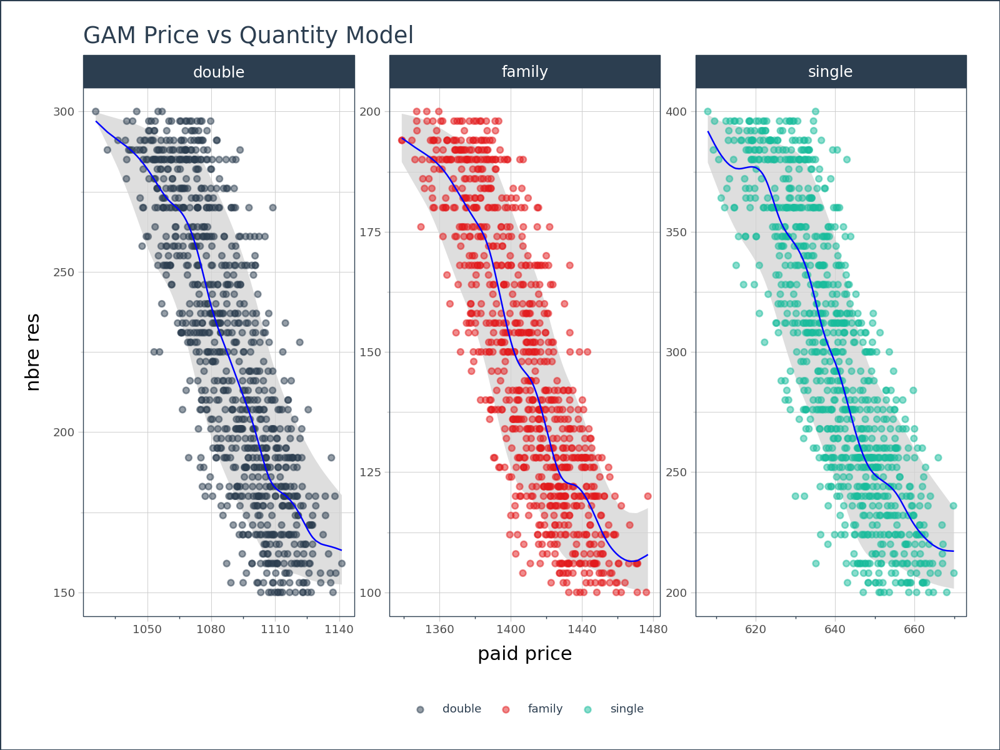

In [124]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [125]:
df_Every_day_pred6 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [126]:
data_filtered7 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_promo') & 
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X7 = data_filtered7[['paid price']]
y7 = data_filtered7['nbre res']

print(len(X7))


2561


In [127]:
# Create a list of unique products
unique_products = data_filtered7['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered7[data_filtered7['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9774,2024-02-01,40,625.89,single,240,160457.66,231.663121,280.112240,336.571537
9790,2024-02-01,32,646.98,single,240,160457.66,204.082102,220.569708,260.968670
9862,2024-02-01,26,643.16,single,240,160457.66,205.588630,227.941163,263.952561
9905,2024-02-01,28,628.49,single,240,160457.66,223.652919,270.099782,319.630284
10345,2024-02-02,39,607.63,single,396,254636.24,324.678850,370.487614,392.719059
...,...,...,...,...,...,...,...,...,...
256655,2025-05-29,32,1360.59,family,142,207683.11,139.530790,164.191614,187.809064
257315,2025-05-30,32,1341.19,family,184,261424.47,156.031324,179.405079,193.007826
257316,2025-05-30,23,1343.63,family,184,261424.47,154.306477,177.735405,192.366598
257328,2025-05-30,27,1354.52,family,184,261424.47,146.358123,169.359988,189.508847


In [128]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1220,54.36,44.86
1,single,0.500,0.6985,31.85,25.13
2,single,0.975,0.1528,53.40,43.30
3,double,0.025,0.1073,40.05,32.64
4,double,0.500,0.6785,24.04,19.10
5,double,0.975,0.0474,41.37,33.98
6,family,0.025,0.1588,26.67,21.88
7,family,0.500,0.6975,15.99,12.81
8,family,0.975,0.1416,26.95,21.99


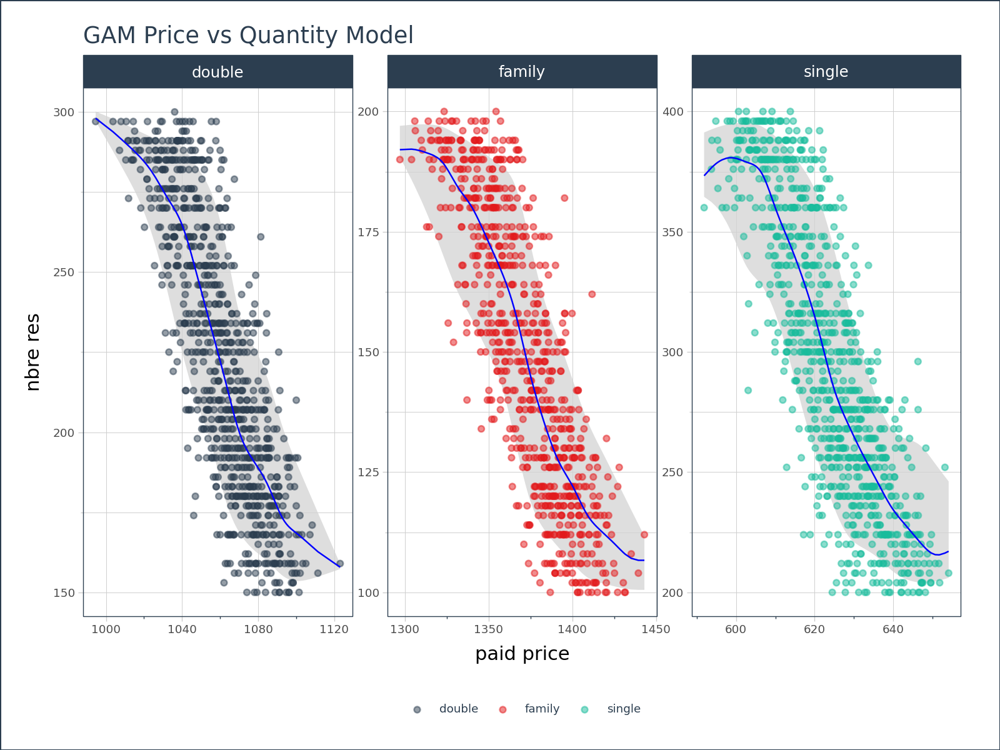

In [129]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [130]:
df_Every_day_pred7 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [131]:
data_filtered8 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_promo') & 
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X8 = data_filtered8[['paid price']]
y8 = data_filtered8['nbre res']

print(len(X8))


2307


In [132]:
# Create a list of unique products
unique_products = data_filtered8['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered8[data_filtered8['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9808,2024-02-01,42,624.07,single,240,160457.66,209.377933,234.690055,263.372321
10391,2024-02-02,57,585.57,single,396,254636.24,352.661364,379.541605,394.942691
10447,2024-02-02,44,591.20,single,396,254636.24,325.068556,367.809842,390.186254
10504,2024-02-02,51,592.62,single,396,254636.24,317.842881,362.090966,387.660802
12151,2024-02-05,44,619.20,single,264,173853.82,216.992569,247.450064,283.835920
...,...,...,...,...,...,...,...,...,...
257362,2025-05-30,49,1312.30,family,184,261424.47,153.563679,176.426444,193.068656
257400,2025-05-30,52,1292.50,family,184,261424.47,171.001248,186.295329,195.322428
257433,2025-05-30,59,1261.74,family,184,261424.47,182.812708,191.175601,197.700165
257447,2025-05-30,55,1294.41,family,184,261424.47,169.327911,185.335082,195.022917


In [133]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1505,52.40,42.59
1,single,0.500,0.6920,31.55,24.94
2,single,0.975,0.1251,53.18,42.82
3,double,0.025,0.2013,38.70,31.48
4,double,0.500,0.7090,23.36,18.70
5,double,0.975,0.1462,40.02,32.83
6,family,0.025,0.1822,25.73,21.17
7,family,0.500,0.7243,14.94,11.83
8,family,0.975,0.2476,24.68,19.77


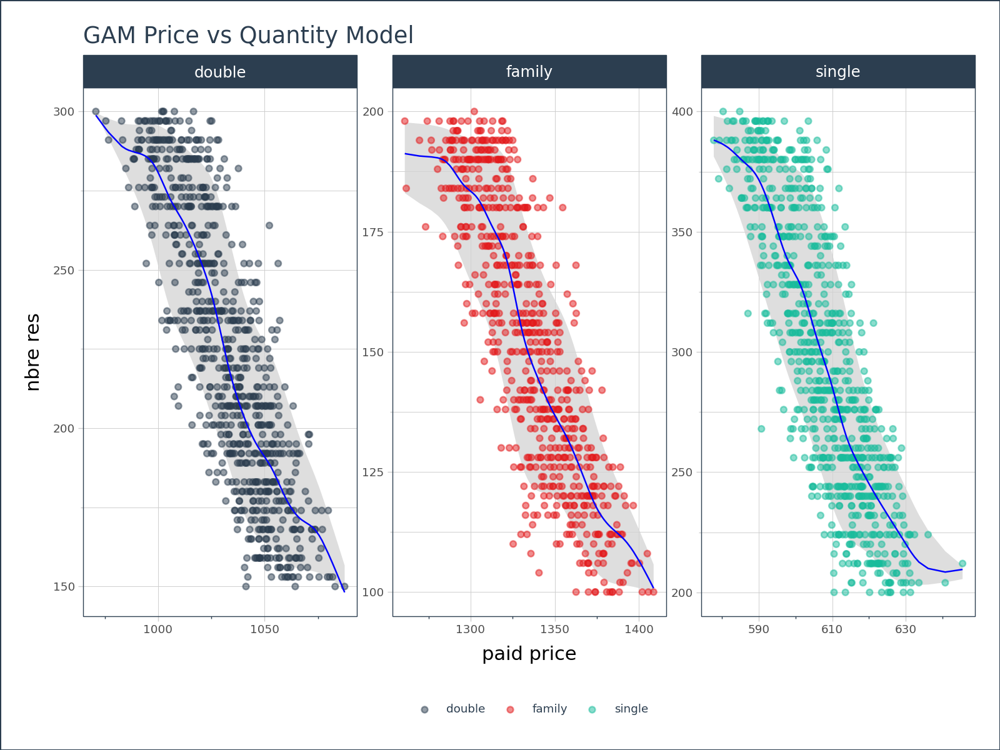

In [134]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [135]:
df_Every_day_pred8 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [136]:
data_filtered9 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_promo') & 
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X9 = data_filtered9[['paid price']]
y9 = data_filtered9['nbre res']

print(len(X9))


2262


In [137]:
# Create a list of unique products
unique_products = data_filtered9['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered9[data_filtered9['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9784,2024-02-01,61,611.19,single,240,160457.66,206.217773,226.471127,261.074929
9820,2024-02-01,66,598.50,single,240,160457.66,223.200488,261.164799,309.969490
9839,2024-02-01,73,606.95,single,240,160457.66,210.916109,238.054921,275.772896
9874,2024-02-01,67,597.23,single,240,160457.66,225.062075,265.014380,314.409842
9902,2024-02-01,75,593.68,single,240,160457.66,231.600124,281.016104,329.901532
...,...,...,...,...,...,...,...,...,...
256538,2025-05-29,63,1321.17,family,142,207683.11,111.350525,129.294014,150.673203
257323,2025-05-30,72,1279.30,family,184,261424.47,145.125785,171.782716,189.854085
257361,2025-05-30,62,1284.23,family,184,261424.47,138.551546,166.691219,187.132579
257431,2025-05-30,66,1274.57,family,184,261424.47,153.356075,176.750008,192.544711


In [138]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.1169,53.68,44.03
1,single,0.500,0.7017,31.20,24.65
2,single,0.975,0.1828,51.64,41.99
3,double,0.025,0.1972,38.95,31.86
4,double,0.500,0.7153,23.19,18.63
5,double,0.975,0.1942,39.02,31.65
6,family,0.025,0.2066,25.29,20.92
7,family,0.500,0.7254,14.88,12.03
8,family,0.975,0.2404,24.75,20.18


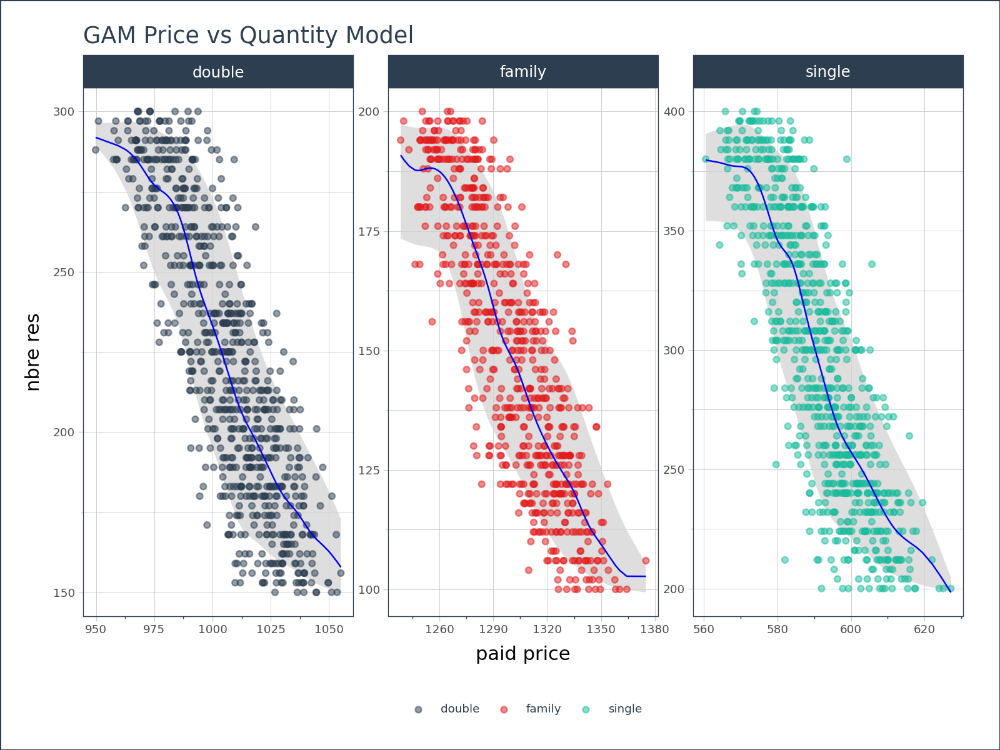

In [139]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [140]:
df_Every_day_pred9 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [141]:
data_filtered10 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_promo') & 
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X10 = data_filtered10[['paid price']]
y10 = data_filtered10['nbre res']

print(len(X10))


1212


In [142]:
# Create a list of unique products
unique_products = data_filtered10['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered10[data_filtered10['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9919,2024-02-01,85,588.70,single,240,160457.66,222.061561,253.706452,289.020341
12157,2024-02-05,83,593.24,single,264,173853.82,210.758052,236.576230,272.395640
12236,2024-02-05,85,578.81,single,264,173853.82,256.397191,299.295783,344.472989
12779,2024-02-06,85,573.74,single,296,195173.94,286.293017,325.005150,367.325756
12780,2024-02-06,84,577.77,single,296,195173.94,262.456505,304.551280,349.941169
...,...,...,...,...,...,...,...,...,...
256534,2025-05-29,89,1270.02,family,142,207683.11,133.325695,155.957177,180.224152
257325,2025-05-30,87,1239.79,family,184,261424.47,174.173558,188.459138,196.504224
257366,2025-05-30,82,1246.74,family,184,261424.47,162.367007,183.849841,194.154123
257427,2025-05-30,86,1247.55,family,184,261424.47,160.943375,183.135338,193.801114


In [143]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,0.4225,42.95,35.30
1,single,0.500,0.7945,25.63,20.59
2,single,0.975,0.3988,43.82,36.14
3,double,0.025,0.3967,32.99,27.14
4,double,0.500,0.7874,19.58,15.37
5,double,0.975,0.3185,35.06,29.56
6,family,0.025,0.3888,22.20,18.23
7,family,0.500,0.8048,12.55,9.43
8,family,0.975,0.4002,21.99,17.99


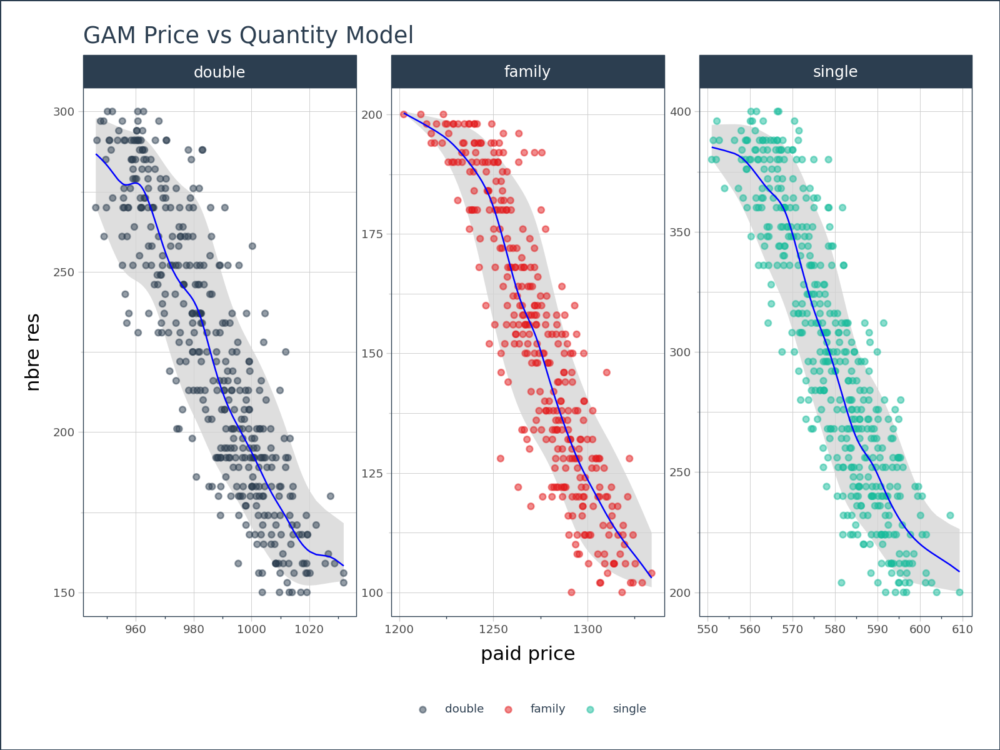

In [144]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [145]:
df_Every_day_pred10 = all_gam_results.copy()

## Event: is-week-end

### Booking Lead in [0 , 20]

In [173]:
data_filtered11 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is-week-end') & 
        ((df_event['booking lead'] >= 0) & (df_event['booking lead'] <= 20))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X11 = data_filtered11[['paid price']]
y11 = data_filtered11['nbre res']

print(len(X11))


3356


In [174]:
# Create a list of unique products
unique_products = data_filtered11['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered11[data_filtered11['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11219,2024-02-03,3,652.89,single,216,130795.78,139.744401,173.010017,215.570478
11229,2024-02-03,18,641.30,single,216,130795.78,163.886201,205.766134,230.110915
11234,2024-02-03,2,651.79,single,216,130795.78,141.817153,176.131082,217.752877
11235,2024-02-03,13,633.83,single,216,130795.78,186.993748,217.879110,233.564404
11239,2024-02-03,0,640.77,single,216,130795.78,165.729029,207.486895,230.580256
...,...,...,...,...,...,...,...,...,...
257743,2025-05-31,3,1441.07,family,62,83938.25,68.280004,84.764786,104.521402
257751,2025-05-31,5,1453.43,family,62,83938.25,66.022772,78.598729,99.723536
257758,2025-05-31,15,1460.18,family,62,83938.25,65.455012,76.676876,95.549049
257767,2025-05-31,7,1467.14,family,62,83938.25,63.150040,71.640313,87.772893


In [175]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5653,42.50,34.64
1,single,0.500,0.4248,25.76,20.94
2,single,0.975,-0.6021,43.00,34.92
3,double,0.025,-0.5006,31.20,25.38
4,double,0.500,0.4532,18.83,15.12
5,double,0.975,-0.5286,31.49,25.27
6,family,0.025,-0.5543,20.84,17.06
7,family,0.500,0.4255,12.67,10.27
8,family,0.975,-0.6563,21.52,17.58


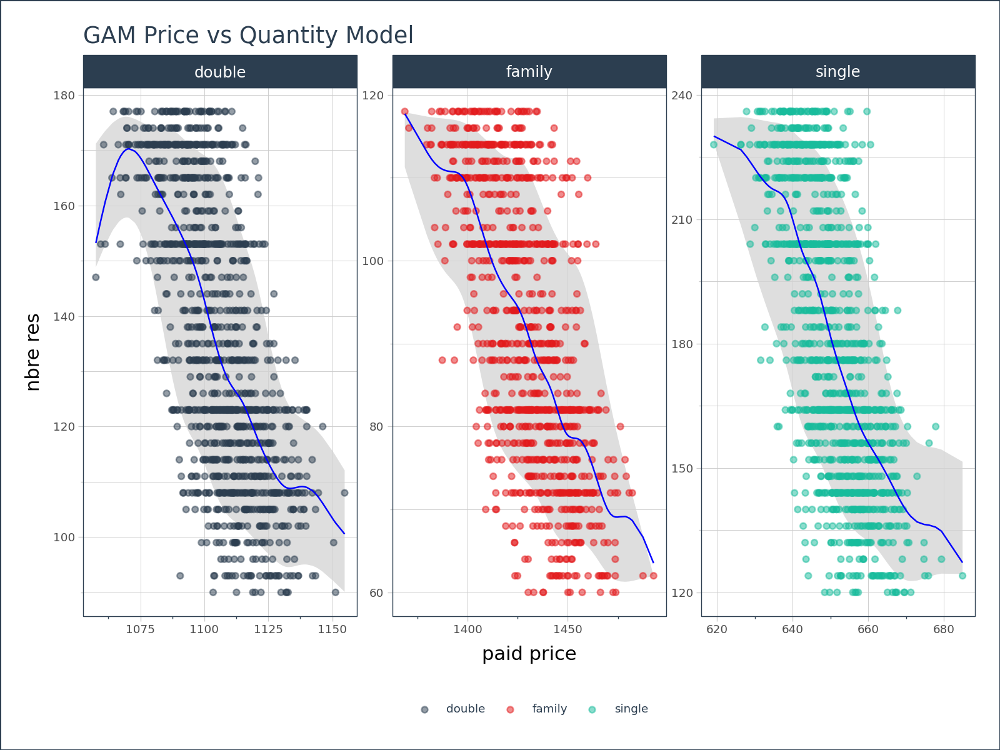

In [176]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [177]:
df_Every_day_pred11 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [178]:
data_filtered12 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is-week-end') & 
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X12 = data_filtered12[['paid price']]
y12 = data_filtered12['nbre res']

print(len(X12))


2801


In [179]:
# Create a list of unique products
unique_products = data_filtered12['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered12[data_filtered12['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11205,2024-02-03,21,630.94,single,216,130795.78,151.673732,188.241604,222.784049
11208,2024-02-03,26,631.64,single,216,130795.78,149.151130,186.009993,222.140124
11231,2024-02-03,23,635.11,single,216,130795.78,143.065207,179.380293,218.450733
11233,2024-02-03,25,631.47,single,216,130795.78,149.732088,186.523108,222.289715
11241,2024-02-03,27,630.32,single,216,130795.78,154.107076,190.418123,223.432175
...,...,...,...,...,...,...,...,...,...
257739,2025-05-31,37,1398.89,family,62,83938.25,70.896851,87.271822,108.439908
257750,2025-05-31,24,1438.84,family,62,83938.25,62.997030,70.803616,91.040439
257761,2025-05-31,36,1410.53,family,62,83938.25,67.464920,80.888691,100.658262
257766,2025-05-31,27,1415.00,family,62,83938.25,65.737407,77.683503,97.242704


In [180]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.3417,39.68,31.77
1,single,0.500,0.4881,24.51,19.82
2,single,0.975,-0.4993,41.95,34.16
3,double,0.025,-0.5221,31.39,25.66
4,double,0.500,0.4450,18.95,15.20
5,double,0.975,-0.5631,31.81,25.53
6,family,0.025,-0.4330,20.25,16.59
7,family,0.500,0.4865,12.12,9.68
8,family,0.975,-0.4927,20.67,16.89


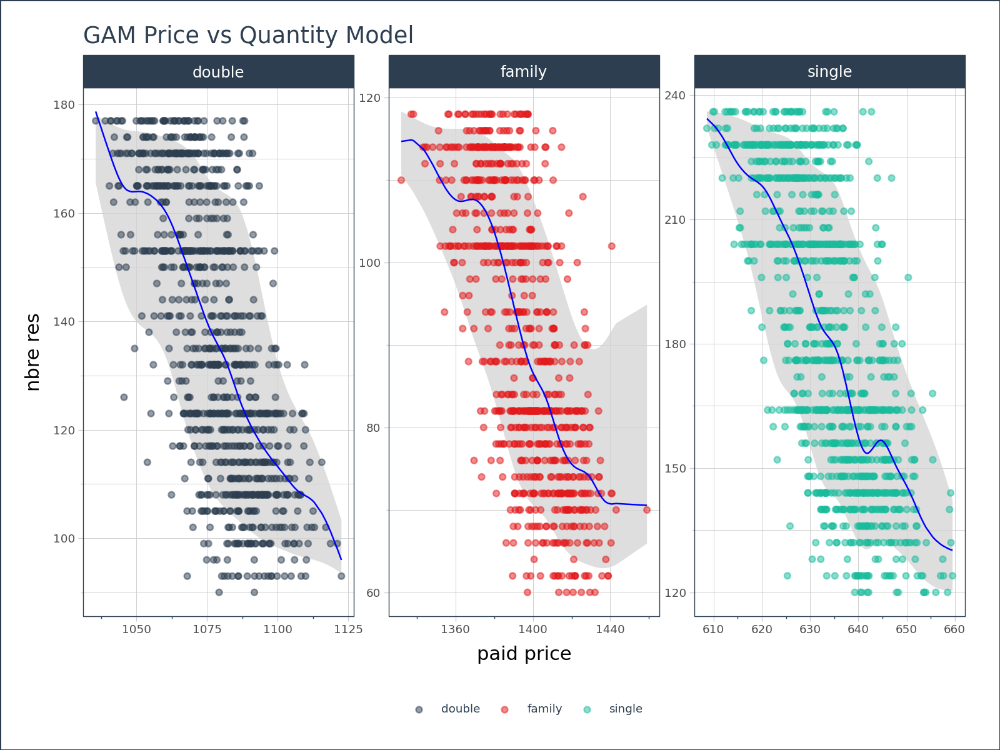

In [181]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [182]:
df_Every_day_pred12 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [183]:
data_filtered13 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is-week-end') & 
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X13 = data_filtered13[['paid price']]
y13 = data_filtered13['nbre res']

print(len(X13))


2423


In [184]:
# Create a list of unique products
unique_products = data_filtered13['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered13[data_filtered13['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11206,2024-02-03,49,607.33,single,216,130795.78,169.835905,207.790017,230.475323
11209,2024-02-03,41,621.03,single,216,130795.78,138.245963,173.019369,215.285199
11214,2024-02-03,55,596.74,single,216,130795.78,201.683939,222.241551,234.192633
11228,2024-02-03,50,612.29,single,216,130795.78,157.903828,196.780920,226.848689
11246,2024-02-03,42,615.55,single,216,130795.78,147.727681,187.035010,224.616425
...,...,...,...,...,...,...,...,...,...
254154,2025-05-25,49,1350.27,family,116,154680.25,79.777538,98.817137,113.656410
254157,2025-05-25,57,1330.05,family,116,154680.25,92.473858,109.468024,116.820519
257726,2025-05-31,56,1369.72,family,62,83938.25,68.050238,83.239497,103.484916
257742,2025-05-31,51,1383.76,family,62,83938.25,64.674512,76.551585,94.830984


In [185]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5786,42.62,34.67
1,single,0.500,0.4030,26.21,21.63
2,single,0.975,-0.6470,43.54,35.36
3,double,0.025,-0.5198,31.81,26.22
4,double,0.500,0.4642,18.89,15.10
5,double,0.975,-0.5268,31.88,25.89
6,family,0.025,-0.3728,20.35,16.81
7,family,0.500,0.5106,12.15,9.72
8,family,0.975,-0.3802,20.40,16.35


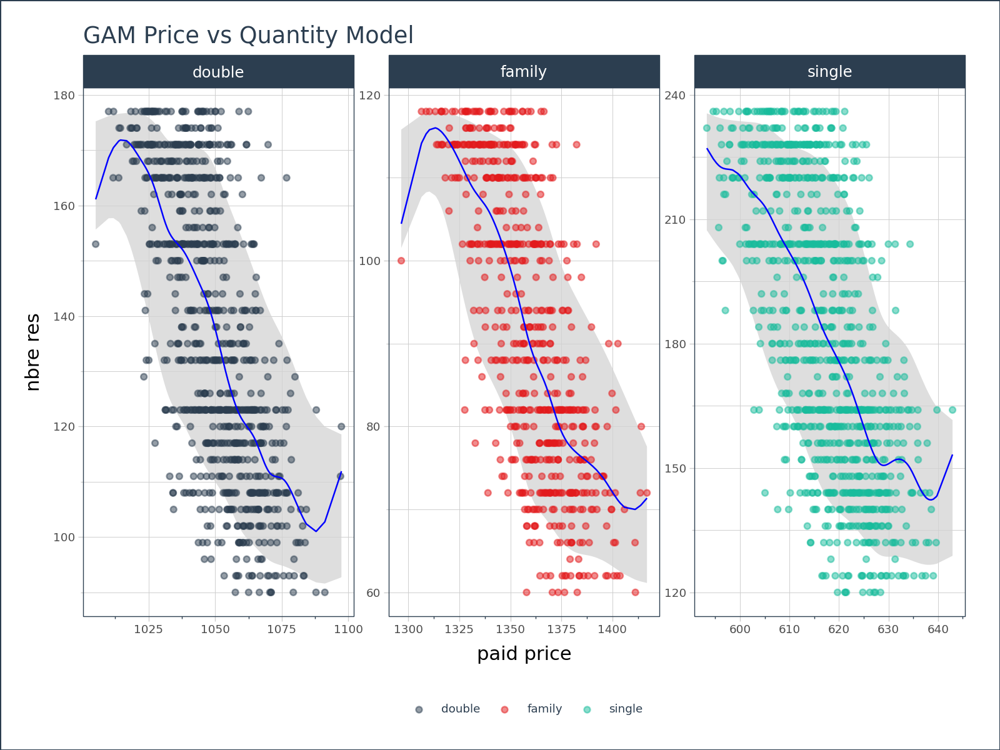

In [186]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [187]:
df_Every_day_pred13 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [188]:
data_filtered14 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is-week-end') & 
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X14 = data_filtered14[['paid price']]
y14 = data_filtered14['nbre res']

print(len(X14))


2397


In [189]:
# Create a list of unique products
unique_products = data_filtered14['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered14[data_filtered14['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11212,2024-02-03,61,598.49,single,216,130795.78,151.929908,191.567682,224.814522
11213,2024-02-03,76,584.94,single,216,130795.78,192.800896,221.771418,233.334945
11218,2024-02-03,71,598.22,single,216,130795.78,152.337017,192.630980,225.314696
11224,2024-02-03,74,578.89,single,216,130795.78,200.060100,222.352113,234.145277
11232,2024-02-03,77,583.39,single,216,130795.78,194.371046,221.573782,233.567772
...,...,...,...,...,...,...,...,...,...
254114,2025-05-25,76,1294.33,family,116,154680.25,92.326004,108.202927,115.898711
254116,2025-05-25,69,1312.81,family,116,154680.25,79.290751,99.402788,113.172291
257717,2025-05-31,75,1339.05,family,62,83938.25,67.556881,80.961803,100.759406
257722,2025-05-31,70,1340.39,family,62,83938.25,67.241100,80.513288,100.115974


In [190]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5599,42.36,35.03
1,single,0.500,0.4569,24.99,20.09
2,single,0.975,-0.4885,41.38,33.33
3,double,0.025,-0.5991,31.71,26.16
4,double,0.500,0.4275,18.98,15.31
5,double,0.975,-0.6112,31.83,25.77
6,family,0.025,-0.5020,20.56,16.76
7,family,0.500,0.4448,12.50,10.04
8,family,0.975,-0.5527,20.91,16.86


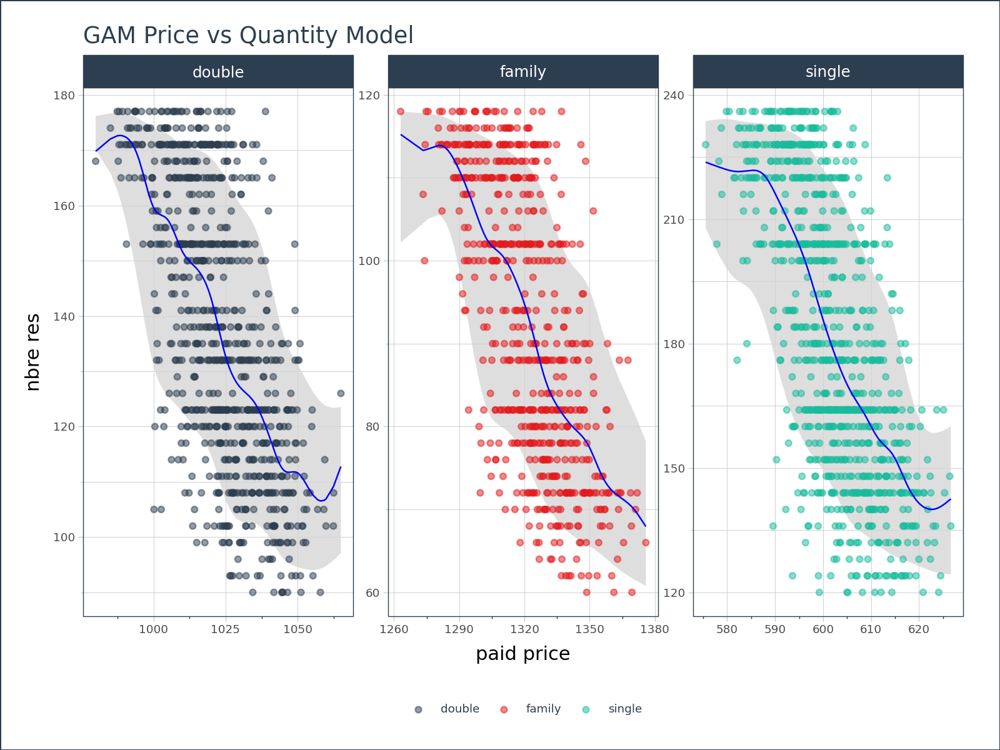

In [191]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [192]:
df_Every_day_pred14 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [193]:
data_filtered15 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is-week-end') & 
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X15 = data_filtered15[['paid price']]
y15 = data_filtered15['nbre res']

print(len(X15))


1233


In [194]:
# Create a list of unique products
unique_products = data_filtered15['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered15[data_filtered15['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11215,2024-02-03,89,580.74,single,216,130795.78,172.317131,211.518095,231.010136
11238,2024-02-03,83,586.44,single,216,130795.78,157.429287,192.640969,225.672467
11240,2024-02-03,82,580.86,single,216,130795.78,171.844346,211.201827,230.935839
11293,2024-02-03,86,576.39,single,216,130795.78,194.705864,221.262575,233.972913
11296,2024-02-03,85,587.20,single,216,130795.78,155.188912,189.046440,224.470949
...,...,...,...,...,...,...,...,...,...
254126,2025-05-25,87,1297.49,family,116,154680.25,74.318344,93.416157,110.343721
254131,2025-05-25,82,1260.64,family,116,154680.25,101.377990,114.777934,117.686474
254137,2025-05-25,90,1284.87,family,116,154680.25,82.605752,101.737325,114.254793
257734,2025-05-31,83,1352.30,family,62,83938.25,60.581967,62.849166,75.464373


In [195]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.2672,37.96,30.74
1,single,0.500,0.5372,22.94,18.14
2,single,0.975,-0.3672,39.43,32.21
3,double,0.025,-0.2562,28.75,23.72
4,double,0.500,0.5853,16.52,12.76
5,double,0.975,-0.2385,28.54,22.90
6,family,0.025,-0.3256,20.09,16.93
7,family,0.500,0.5724,11.41,8.92
8,family,0.975,-0.1879,19.02,14.99


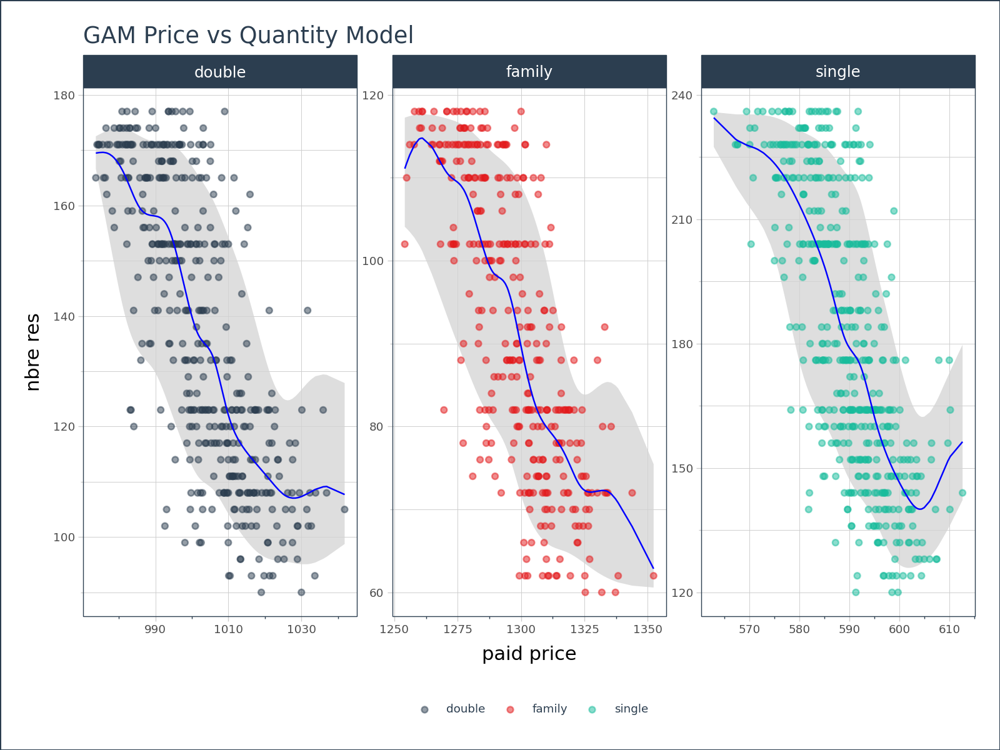

In [196]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [197]:
df_Every_day_pred15 = all_gam_results.copy()

## Event: is_week_end_promo

### Booking Lead in [0 , 20]

In [214]:
data_filtered16 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_week_end_promo') & 
        ((df_event['booking lead'] >= 0) & (df_event['booking lead'] <= 20))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X16 = data_filtered16[['paid price']]
y16 = data_filtered16['nbre res']

print(len(X16))


1746


In [215]:
# Create a list of unique products
unique_products = data_filtered16['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered16[data_filtered16['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11225,2024-02-03,1,606.17,single,216,130795.78,133.719540,159.527685,197.063366
11256,2024-02-03,10,589.79,single,216,130795.78,164.504806,200.227989,226.823297
11269,2024-02-03,4,596.90,single,216,130795.78,145.735510,178.679128,218.612391
11693,2024-02-04,16,600.09,single,204,125479.62,140.138093,168.923767,213.211303
11695,2024-02-04,9,596.53,single,204,125479.62,146.402994,179.855420,219.264221
...,...,...,...,...,...,...,...,...,...
257729,2025-05-31,1,1363.58,family,62,83938.25,62.638208,70.625340,79.735930
257745,2025-05-31,12,1335.62,family,62,83938.25,66.404258,78.341107,95.657478
257747,2025-05-31,2,1358.65,family,62,83938.25,63.638639,71.953885,81.497984
257770,2025-05-31,18,1329.77,family,62,83938.25,68.078544,81.826072,103.870856


In [216]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5194,36.48,28.97
1,single,0.500,0.3855,23.20,18.47
2,single,0.975,-1.0552,42.43,36.34
3,double,0.025,-0.5962,27.90,22.22
4,double,0.500,0.3593,17.68,14.25
5,double,0.975,-1.0862,31.89,27.27
6,family,0.025,-0.5238,19.47,15.37
7,family,0.500,0.4008,12.21,9.72
8,family,0.975,-0.8876,21.67,18.04


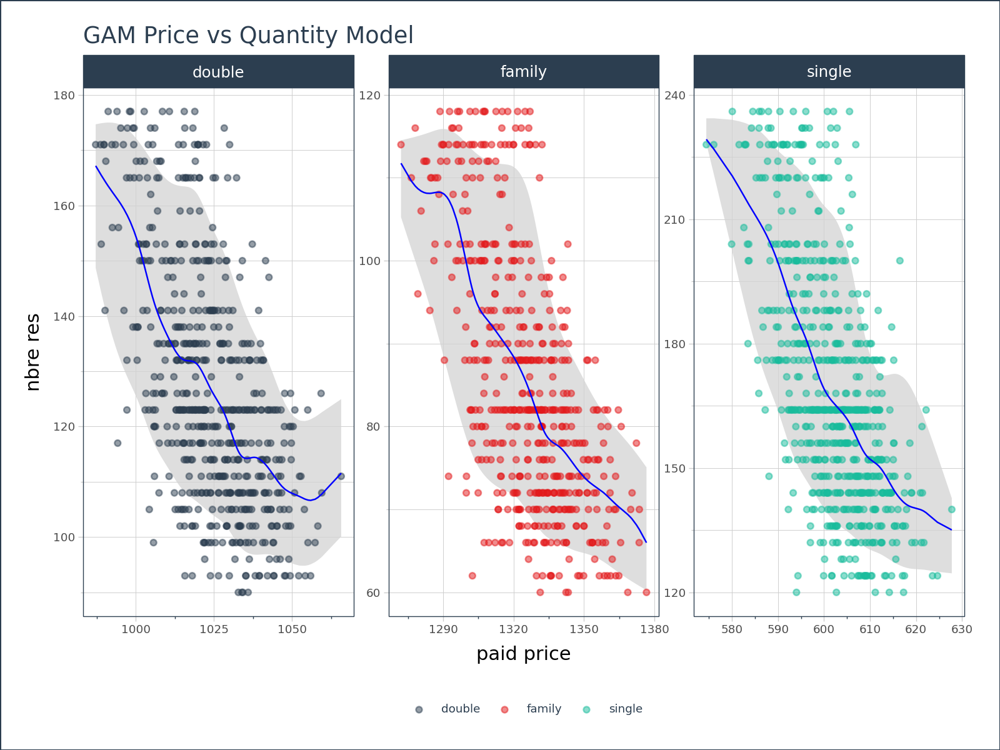

In [217]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [218]:
df_Every_day_pred16 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [219]:
data_filtered17 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_week_end_promo') & 
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X17 = data_filtered17[['paid price']]
y17 = data_filtered17['nbre res']

print(len(X17))


1425


In [220]:
# Create a list of unique products
unique_products = data_filtered17['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered17[data_filtered17['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11211,2024-02-03,29,575.45,single,216,130795.78,159.525598,203.728142,231.298276
11227,2024-02-03,22,592.01,single,216,130795.78,133.858444,160.270591,200.117778
11248,2024-02-03,28,577.72,single,216,130795.78,153.377330,193.020654,226.990217
11259,2024-02-03,33,579.87,single,216,130795.78,147.331083,181.541902,222.219503
11774,2024-02-04,23,593.32,single,204,125479.62,134.226141,158.874609,194.521235
...,...,...,...,...,...,...,...,...,...
257730,2025-05-31,32,1302.09,family,62,83938.25,64.849963,76.307889,91.616264
257740,2025-05-31,25,1290.94,family,62,83938.25,67.958344,83.443022,102.904936
257753,2025-05-31,26,1326.91,family,62,83938.25,61.775489,69.470497,83.269320
257762,2025-05-31,23,1338.41,family,62,83938.25,55.678784,62.276064,73.789093


In [221]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.6951,39.69,31.69
1,single,0.500,0.3403,24.76,19.84
2,single,0.975,-1.1657,44.86,38.44
3,double,0.025,-0.5628,28.63,23.40
4,double,0.500,0.4450,17.06,13.56
5,double,0.975,-0.6468,29.39,24.85
6,family,0.025,-0.5893,19.49,15.70
7,family,0.500,0.4008,11.97,9.64
8,family,0.975,-0.8460,21.01,17.68


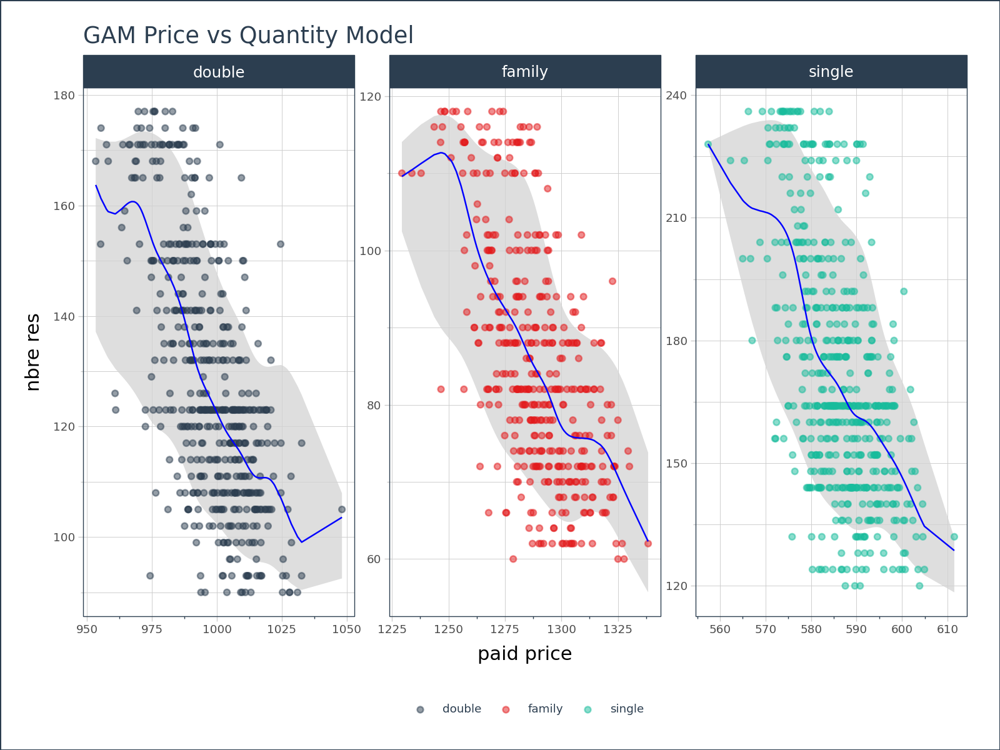

In [222]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [223]:
df_Every_day_pred17 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [229]:
data_filtered18 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_week_end_promo') & 
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X18 = data_filtered18[['paid price']]
y18 = data_filtered18['nbre res']

print(len(X18))


1239


In [230]:
# Create a list of unique products
unique_products = data_filtered18['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered18[data_filtered18['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11210,2024-02-03,51,562.85,single,216,130795.78,153.597418,187.409443,223.459142
11216,2024-02-03,46,555.77,single,216,130795.78,170.976401,207.529323,230.677677
11220,2024-02-03,56,556.86,single,216,130795.78,167.416452,203.885159,229.887564
11223,2024-02-03,52,552.98,single,216,130795.78,180.779465,215.493975,232.420030
11230,2024-02-03,43,577.37,single,216,130795.78,132.177395,155.140944,190.719730
...,...,...,...,...,...,...,...,...,...
257725,2025-05-31,49,1282.07,family,62,83938.25,63.515816,72.022677,84.733732
257733,2025-05-31,52,1247.66,family,62,83938.25,69.745227,86.914409,106.006375
257738,2025-05-31,59,1256.33,family,62,83938.25,69.219608,83.982119,105.086899
257756,2025-05-31,60,1260.60,family,62,83938.25,68.074642,81.769979,102.621843


In [231]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.4335,37.34,29.88
1,single,0.500,0.4273,23.60,19.03
2,single,0.975,-0.8374,42.28,36.11
3,double,0.025,-0.6573,29.98,24.25
4,double,0.500,0.3592,18.64,15.29
5,double,0.975,-0.8231,31.44,26.08
6,family,0.025,-0.7646,19.88,15.91
7,family,0.500,0.3184,12.35,9.86
8,family,0.975,-1.1070,21.72,18.41


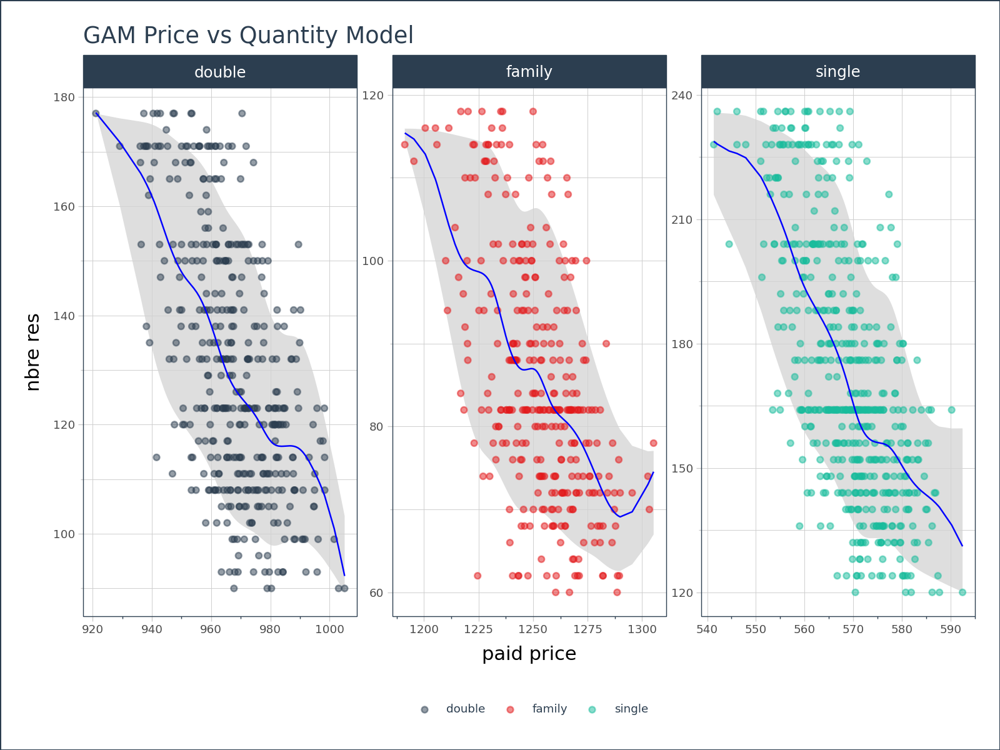

In [232]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [233]:
df_Every_day_pred18 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [234]:
data_filtered19 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_week_end_promo') & 
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X19 = data_filtered19[['paid price']]
y19 = data_filtered19['nbre res']

print(len(X19))


1261


In [235]:
# Create a list of unique products
unique_products = data_filtered19['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered19[data_filtered19['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11207,2024-02-03,80,541.20,single,216,130795.78,166.196860,198.189814,227.104047
11221,2024-02-03,78,537.87,single,216,130795.78,177.440598,213.298985,232.147246
11339,2024-02-03,66,550.35,single,216,130795.78,144.409358,177.235554,217.230207
11714,2024-02-04,72,540.39,single,204,125479.62,168.856496,202.515469,228.638191
11750,2024-02-04,77,554.61,single,204,125479.62,138.308993,165.656394,205.141050
...,...,...,...,...,...,...,...,...,...
254097,2025-05-25,74,1192.75,family,116,154680.25,83.894945,101.077204,114.702679
257718,2025-05-31,66,1245.64,family,62,83938.25,65.725426,74.939741,90.176665
257731,2025-05-31,77,1216.36,family,62,83938.25,69.050814,84.986852,107.591562
257749,2025-05-31,76,1220.47,family,62,83938.25,67.532464,82.758386,103.294150


In [236]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5117,35.56,28.18
1,single,0.500,0.3846,22.69,18.16
2,single,0.975,-1.0433,41.34,35.46
3,double,0.025,-0.4346,27.86,21.99
4,double,0.500,0.4520,17.22,13.79
5,double,0.975,-0.7195,30.50,25.64
6,family,0.025,-0.5590,19.48,15.44
7,family,0.500,0.3683,12.40,10.01
8,family,0.975,-0.9985,22.06,18.84


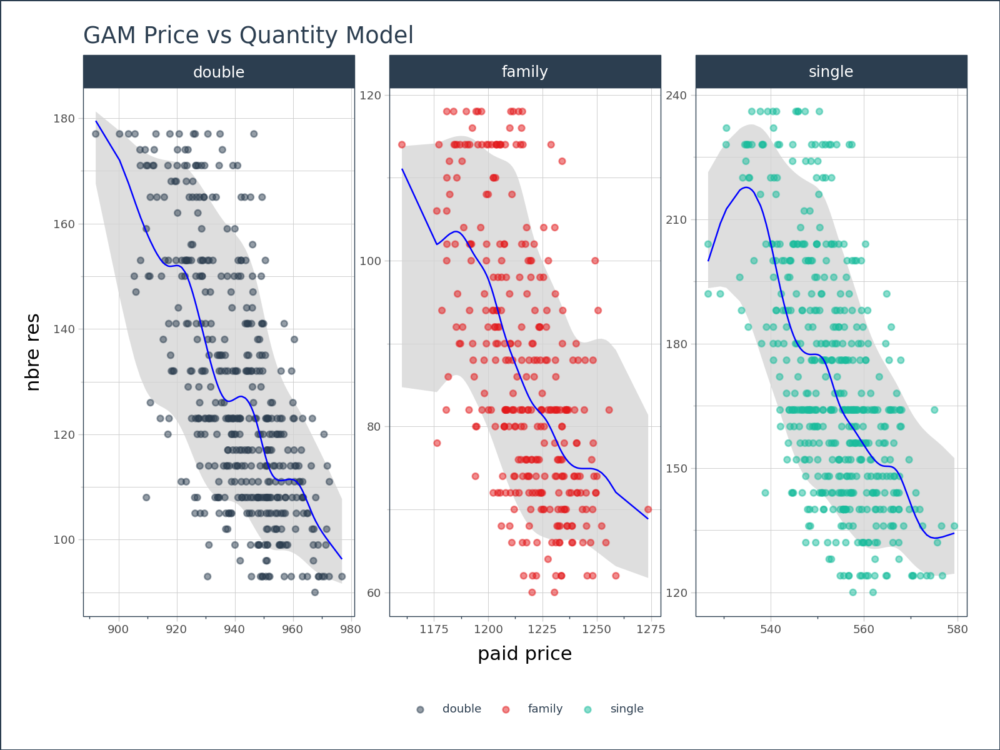

In [237]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [238]:
df_Every_day_pred19 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [239]:
data_filtered20 = (
    df_event[
        (df_event['arr month'].isin([2, 3, 4, 5, 9, 10, 11])) &
        (df_event['event'] == 'is_week_end_promo') & 
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)

X20 = data_filtered20[['paid price']]
y20 = data_filtered20['nbre res']

print(len(X20))


645


In [240]:
# Create a list of unique products
unique_products = data_filtered20['type de chambre'].unique()

# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered20[data_filtered20['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
11217,2024-02-03,87,540.72,single,216,130795.78,143.859339,173.724066,211.721536
15361,2024-02-10,83,534.44,single,236,143198.99,156.170169,198.580925,226.443145
15438,2024-02-10,87,531.80,single,236,143198.99,168.367876,207.819494,229.776889
15553,2024-02-10,88,534.18,single,236,143198.99,157.206641,200.292025,227.086244
15912,2024-02-11,82,538.64,single,160,98890.35,147.395649,174.824626,214.957263
...,...,...,...,...,...,...,...,...,...
253614,2025-05-24,90,1191.01,family,100,132161.01,73.402255,86.537027,98.311358
254047,2025-05-25,84,1172.25,family,116,154680.25,80.919984,101.710095,113.888104
254077,2025-05-25,85,1158.32,family,116,154680.25,93.269945,108.708385,116.261942
254110,2025-05-25,86,1178.45,family,116,154680.25,75.211848,95.671663,111.234719


In [241]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.4270,36.07,29.12
1,single,0.500,0.4823,21.73,17.15
2,single,0.975,-0.7360,39.79,34.10
3,double,0.025,-0.4324,26.61,21.36
4,double,0.500,0.4605,16.33,12.76
5,double,0.975,-0.7792,29.65,25.37
6,family,0.025,-0.3358,17.20,13.95
7,family,0.500,0.5554,9.92,7.93
8,family,0.975,-0.2095,16.37,13.38


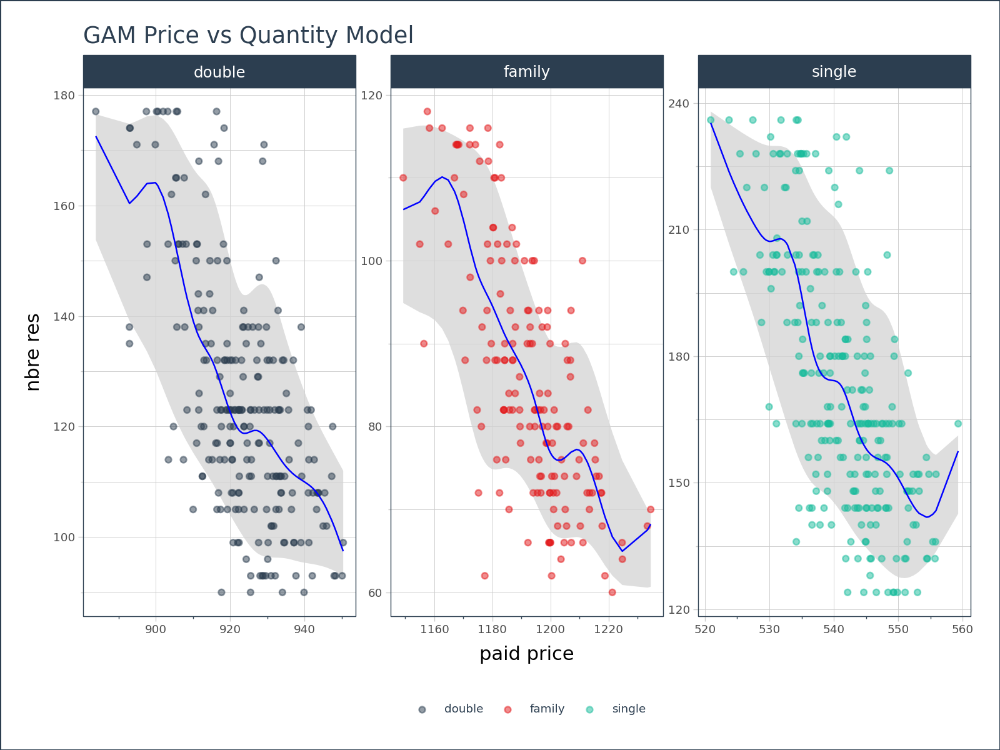

In [242]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [243]:
df_Every_day_pred20 = all_gam_results.copy()

## concaténation

In [247]:
# Liste contenant tous les DataFrames
all_dfs = [
    df_Every_day_pred1,
    df_Every_day_pred2,
    df_Every_day_pred3,
    df_Every_day_pred4,
    df_Every_day_pred5,
    df_Every_day_pred6,
    df_Every_day_pred7,
    df_Every_day_pred8,
    df_Every_day_pred9,
    df_Every_day_pred10,
    df_Every_day_pred11,
    df_Every_day_pred12,
    df_Every_day_pred13,
    df_Every_day_pred14,
    df_Every_day_pred15,
    df_Every_day_pred16,
    df_Every_day_pred17,
    df_Every_day_pred18,
    df_Every_day_pred19,
    df_Every_day_pred20
]

# Concaténer sans réinitialiser l’index
df_all = pd.concat(all_dfs, axis=0)

# Optionnel : vérifier les dimensions
print(df_all.shape)


(74194, 9)


In [248]:
df_all

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9775,2024-02-01,3,711.12,single,240,160457.66,206.741006,227.480859,259.951502
9776,2024-02-01,12,696.22,single,240,160457.66,222.645908,265.939479,315.015960
9778,2024-02-01,0,714.66,single,240,160457.66,205.139380,223.541960,252.171475
9780,2024-02-01,9,704.80,single,240,160457.66,212.677914,240.965521,277.791471
9791,2024-02-01,20,691.33,single,240,160457.66,240.836069,285.716116,341.581753
...,...,...,...,...,...,...,...,...,...
253614,2025-05-24,90,1191.01,family,100,132161.01,73.402255,86.537027,98.311358
254047,2025-05-25,84,1172.25,family,116,154680.25,80.919984,101.710095,113.888104
254077,2025-05-25,85,1158.32,family,116,154680.25,93.269945,108.708385,116.261942
254110,2025-05-25,86,1178.45,family,116,154680.25,75.211848,95.671663,111.234719


In [249]:
df_event

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,nbre res,paid price,rev par type de chambre,event
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,144,728.13,97643.77,no_promo
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,144,676.01,97643.77,no_promo
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,144,667.57,97643.77,no_promo
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,144,639.01,97643.77,is_promo
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,144,722.32,97643.77,no_promo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,70,1465.57,104947.60,no_promo
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,70,1592.27,104947.60,no_promo
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,70,1468.10,104947.60,is_promo
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,70,1470.13,104947.60,is_promo


In [250]:
# Fusionner les deux DataFrames sur les colonnes souhaitées
df_event = df_event.merge(
    df_all[['arrival day', 'type de chambre', 'booking lead', 'pred_q0.025', 'pred_q0.5', 'pred_q0.975']],
    on=['arrival day', 'type de chambre', 'booking lead'],
    how='left'
)


In [251]:
df_event

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,nbre res,paid price,rev par type de chambre,event,pred_q0.025,pred_q0.5,pred_q0.975
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,144,728.13,97643.77,no_promo,NaN,NaN,NaN
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,144,676.01,97643.77,no_promo,NaN,NaN,NaN
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,144,667.57,97643.77,no_promo,NaN,NaN,NaN
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,144,639.01,97643.77,is_promo,NaN,NaN,NaN
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,144,722.32,97643.77,no_promo,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,70,1465.57,104947.60,no_promo,NaN,NaN,NaN
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,70,1592.27,104947.60,no_promo,NaN,NaN,NaN
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,70,1468.10,104947.60,is_promo,NaN,NaN,NaN
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,70,1470.13,104947.60,is_promo,NaN,NaN,NaN


In [253]:
df_event.iloc[253614]

arrival day                2025-05-24 00:00:00
type de chambre                         family
booking lead                                90
is-week-end                               True
res day                    2025-02-23 00:00:00
season                               printemps
arr month                                    5
arr day                                     24
is_promo                                  True
taux occ arr                               0.5
nbre res                                   100
paid price                             1191.01
rev par type de chambre              132161.01
event                        is_week_end_promo
pred_q0.025                          73.402255
pred_q0.5                            86.537027
pred_q0.975                          98.311358
Name: 253614, dtype: object

# Months: 6, 7, 8, 12, 1

## Event: no_promo

### Booking Lead in [0 , 20]

In [256]:
data_filtered21 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        (df_event['event'] == 'no_promo') &
        (df_event['booking lead'] <= 20)
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X21 = data_filtered21[['paid price']]
y21= data_filtered21['nbre res']

print(len(X21)) 

5567


In [257]:
# Create a list of unique products
unique_products = data_filtered21['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [258]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered21[data_filtered21['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
0,2024-01-01,2,728.13,single,144,97643.77,124.368396,139.183923,166.975651
4,2024-01-01,0,722.32,single,144,97643.77,126.174469,148.988993,187.222608
11,2024-01-01,5,720.21,single,144,97643.77,126.896706,154.161935,194.082516
17,2024-01-01,3,723.45,single,144,97643.77,125.821179,146.349469,183.692557
18,2024-01-01,18,710.50,single,144,97643.77,139.372864,181.864880,222.869680
...,...,...,...,...,...,...,...,...,...
267951,2025-06-30,17,1576.32,family,70,104947.60,66.005816,82.833205,105.004084
267961,2025-06-30,8,1588.31,family,70,104947.60,63.367784,75.623530,95.591887
267962,2025-06-30,10,1577.75,family,70,104947.60,65.615130,81.957522,104.104680
267964,2025-06-30,15,1582.11,family,70,104947.60,64.663518,79.972241,101.261966


In [259]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5231,44.81,36.80
1,single,0.500,0.4577,26.74,21.66
2,single,0.975,-0.4841,44.24,35.63
3,double,0.025,-0.5527,33.71,27.74
4,double,0.500,0.4615,19.85,16.10
5,double,0.975,-0.4612,32.70,26.34
6,family,0.025,-0.6694,23.25,19.13
7,family,0.500,0.4264,13.63,11.07
8,family,0.975,-0.4931,21.99,17.46


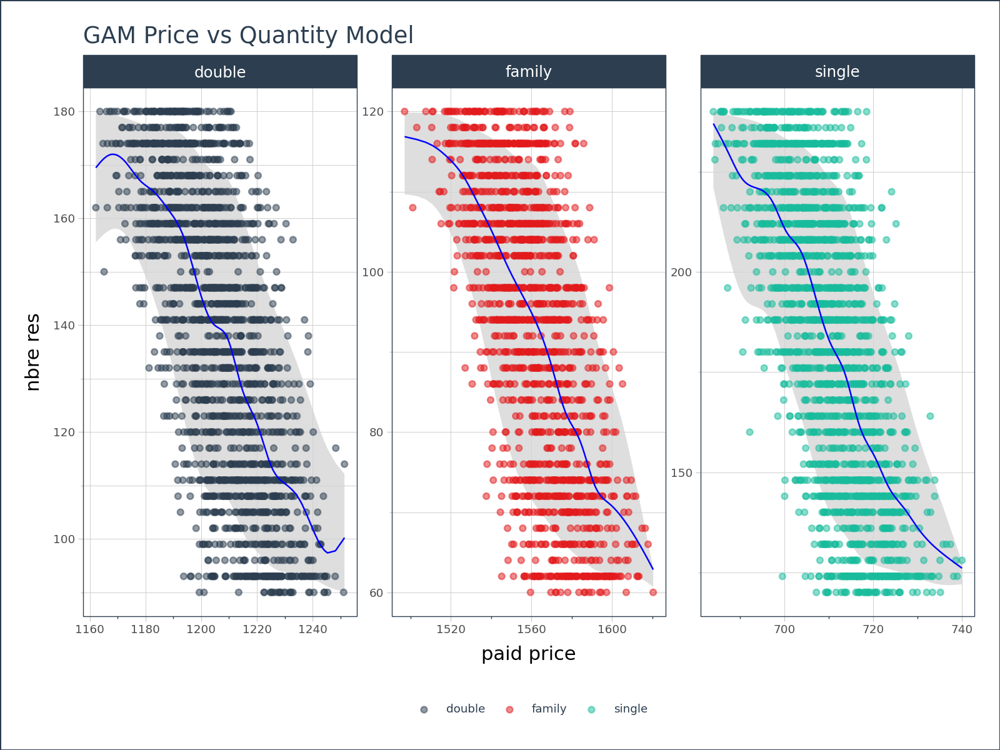

In [260]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [261]:
df_Every_day_pred21 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [268]:
data_filtered22 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X22 = data_filtered22[['paid price']]
y22= data_filtered22['nbre res']

print(len(X22)) 

4688


In [269]:
# Create a list of unique products
unique_products = data_filtered22['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [270]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered22[data_filtered22['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
9,2024-01-01,28,698.26,single,144,97643.77,137.004417,171.980421,210.373149
12,2024-01-01,31,705.16,single,144,97643.77,126.731160,150.985401,191.040511
13,2024-01-01,36,689.85,single,144,97643.77,154.226947,198.065445,229.741485
14,2024-01-01,26,709.29,single,144,97643.77,125.324203,143.935969,175.761348
22,2024-01-01,24,699.63,single,144,97643.77,134.353753,167.746291,206.802650
...,...,...,...,...,...,...,...,...,...
267913,2025-06-30,34,1510.15,family,70,104947.60,83.717562,104.452789,116.537227
267916,2025-06-30,33,1537.10,family,70,104947.60,65.958981,84.542287,105.930417
267953,2025-06-30,39,1512.54,family,70,104947.60,82.733323,103.523480,116.232224
267954,2025-06-30,31,1549.15,family,70,104947.60,63.569021,76.184509,95.021607


In [271]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.4671,43.30,35.75
1,single,0.500,0.4888,25.56,20.72
2,single,0.975,-0.3673,41.80,33.59
3,double,0.025,-0.5598,33.77,27.98
4,double,0.500,0.4658,19.76,16.08
5,double,0.975,-0.3773,31.73,25.21
6,family,0.025,-0.4977,21.99,18.55
7,family,0.500,0.5140,12.53,10.03
8,family,0.975,-0.3110,20.58,16.52


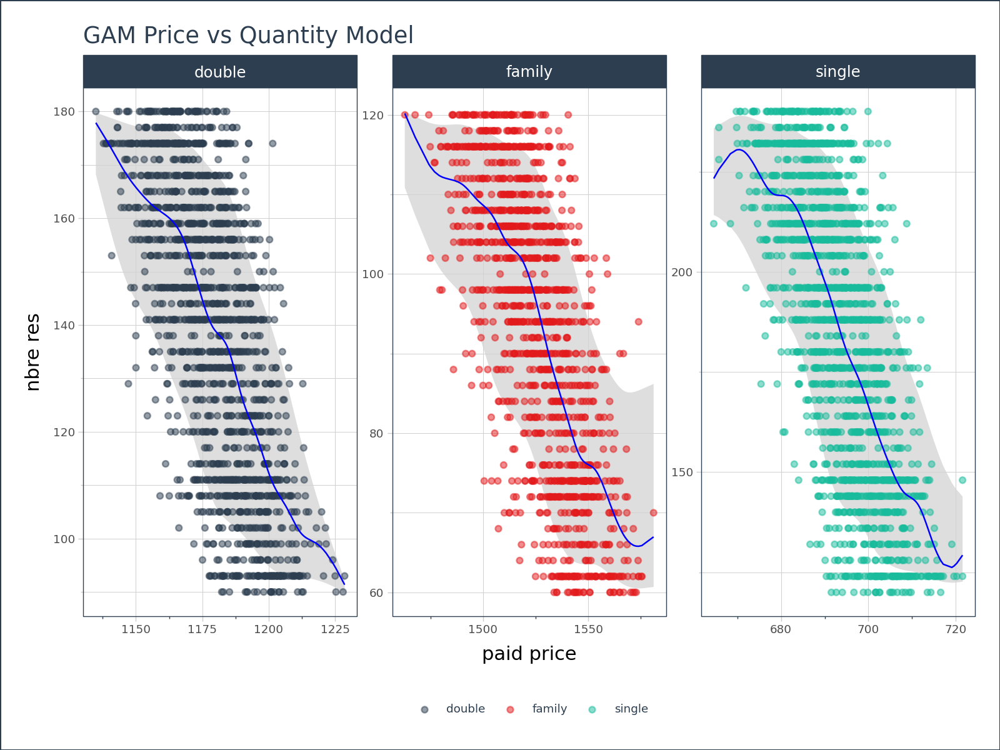

In [272]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [273]:
df_Every_day_pred22 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [274]:
data_filtered23 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X23 = data_filtered23[['paid price']]
y23 = data_filtered23['nbre res']

print(len(X23)) 

4016


In [275]:
# Create a list of unique products
unique_products = data_filtered23['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [276]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered23[data_filtered23['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
28,2024-01-01,60,667.80,single,144,97643.77,173.829408,210.375037,232.966790
32,2024-01-01,58,670.38,single,144,97643.77,165.479272,204.173457,230.364961
36,2024-01-01,53,678.23,single,144,97643.77,141.286735,181.740116,222.010091
48,2024-01-01,52,681.93,single,144,97643.77,132.692745,168.777324,211.412576
64,2024-01-01,56,678.17,single,144,97643.77,141.476770,182.010662,222.187384
...,...,...,...,...,...,...,...,...,...
267210,2025-06-27,59,1469.56,family,116,171770.48,85.594464,105.654985,116.648750
267908,2025-06-30,48,1478.09,family,70,104947.60,78.594646,101.052913,116.029842
267928,2025-06-30,42,1510.85,family,70,104947.60,64.193286,77.379806,97.595650
267942,2025-06-30,53,1509.93,family,70,104947.60,64.507978,78.232822,98.666092


In [277]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.4841,43.43,35.85
1,single,0.500,0.4820,25.66,20.93
2,single,0.975,-0.3959,42.12,33.77
3,double,0.025,-0.5707,33.94,28.24
4,double,0.500,0.4901,19.34,15.49
5,double,0.975,-0.3086,30.98,24.57
6,family,0.025,-0.6022,22.93,19.00
7,family,0.500,0.4517,13.41,10.78
8,family,0.975,-0.4443,21.77,17.36


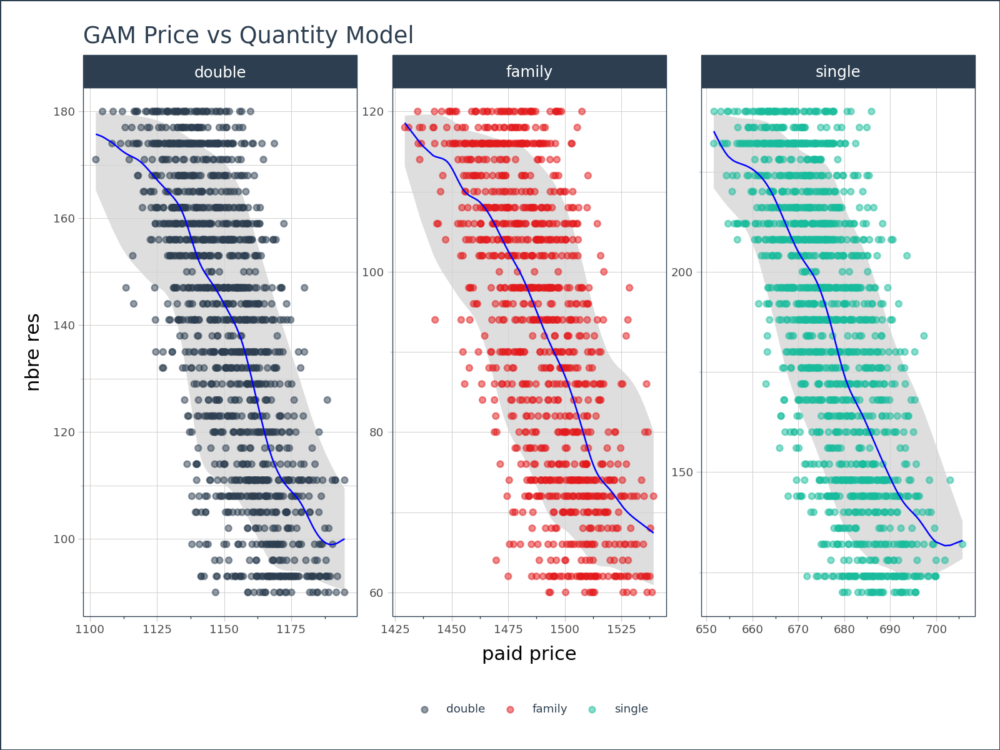

In [278]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [279]:
df_Every_day_pred23 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [280]:
data_filtered24 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X24 = data_filtered24[['paid price']]
y24= data_filtered24['nbre res']

print(len(X24)) 

4068


In [282]:
# Create a list of unique products
unique_products = data_filtered24['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [283]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered24[data_filtered24['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
1,2024-01-01,62,676.01,single,144,97643.77,124.932669,141.352999,173.010672
2,2024-01-01,71,667.57,single,144,97643.77,131.622044,166.973633,210.676371
20,2024-01-01,76,657.26,single,144,97643.77,157.716220,199.912914,229.298726
34,2024-01-01,69,668.06,single,144,97643.77,131.130180,165.737097,209.460809
68,2024-01-01,80,654.43,single,144,97643.77,162.748701,204.011137,230.969185
...,...,...,...,...,...,...,...,...,...
267941,2025-06-30,77,1451.56,family,70,104947.60,74.281184,95.373776,113.630814
267944,2025-06-30,70,1482.98,family,70,104947.60,62.536626,73.533975,92.464980
267946,2025-06-30,78,1453.58,family,70,104947.60,72.544823,93.447652,113.163876
267947,2025-06-30,62,1472.64,family,70,104947.60,65.162057,78.951272,100.120407


In [284]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.4736,44.59,36.39
1,single,0.500,0.4748,26.62,21.48
2,single,0.975,-0.4325,43.96,35.24
3,double,0.025,-0.5017,32.67,27.08
4,double,0.500,0.4744,19.33,15.63
5,double,0.975,-0.4265,31.84,25.53
6,family,0.025,-0.4823,21.84,18.14
7,family,0.500,0.4995,12.69,10.14
8,family,0.975,-0.3670,20.97,16.77


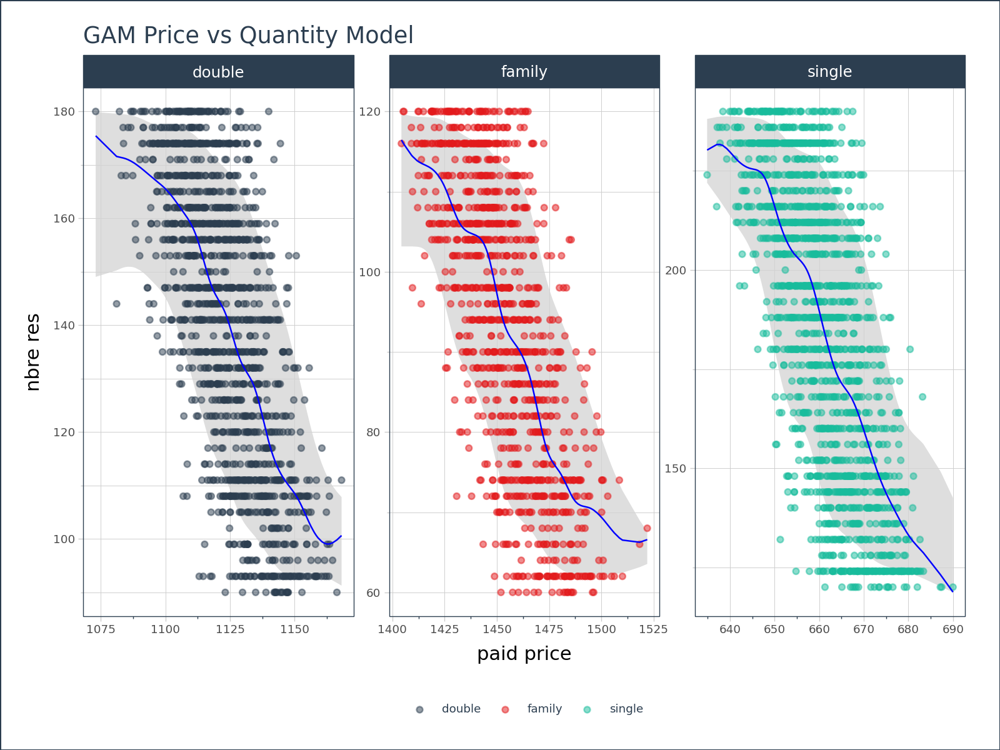

In [285]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [286]:
df_Every_day_pred24 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [287]:
data_filtered25 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'no_promo') &
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X25 = data_filtered25[['paid price']]
y25= data_filtered25['nbre res']

print(len(X25)) 

1982


In [288]:
# Create a list of unique products
unique_products = data_filtered25['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [289]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered25[data_filtered25['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
8,2024-01-01,86,654.16,single,144,97643.77,132.879635,166.366406,206.125712
27,2024-01-01,84,650.55,single,144,97643.77,142.288979,177.625681,216.183918
52,2024-01-01,82,656.82,single,144,97643.77,127.111766,153.807436,195.572527
87,2024-01-01,85,661.77,single,144,97643.77,125.222507,147.386615,184.587180
109,2024-01-01,88,653.41,single,144,97643.77,134.966834,169.141211,208.583098
...,...,...,...,...,...,...,...,...,...
267137,2025-06-27,87,1397.86,family,116,171770.48,102.702403,112.947871,118.895009
267160,2025-06-27,89,1404.19,family,116,171770.48,94.488472,109.549162,117.233711
267190,2025-06-27,82,1411.43,family,116,171770.48,85.638769,105.587451,115.833147
267200,2025-06-27,81,1408.59,family,116,171770.48,88.463929,106.872910,116.101128


In [290]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.1924,40.08,33.17
1,single,0.500,0.5898,23.51,18.71
2,single,0.975,-0.1924,40.08,32.34
3,double,0.025,-0.2846,29.99,24.71
4,double,0.500,0.5569,17.61,14.05
5,double,0.975,-0.2222,29.25,23.27
6,family,0.025,-0.2199,19.65,16.13
7,family,0.500,0.5829,11.49,9.13
8,family,0.975,-0.1802,19.33,15.69


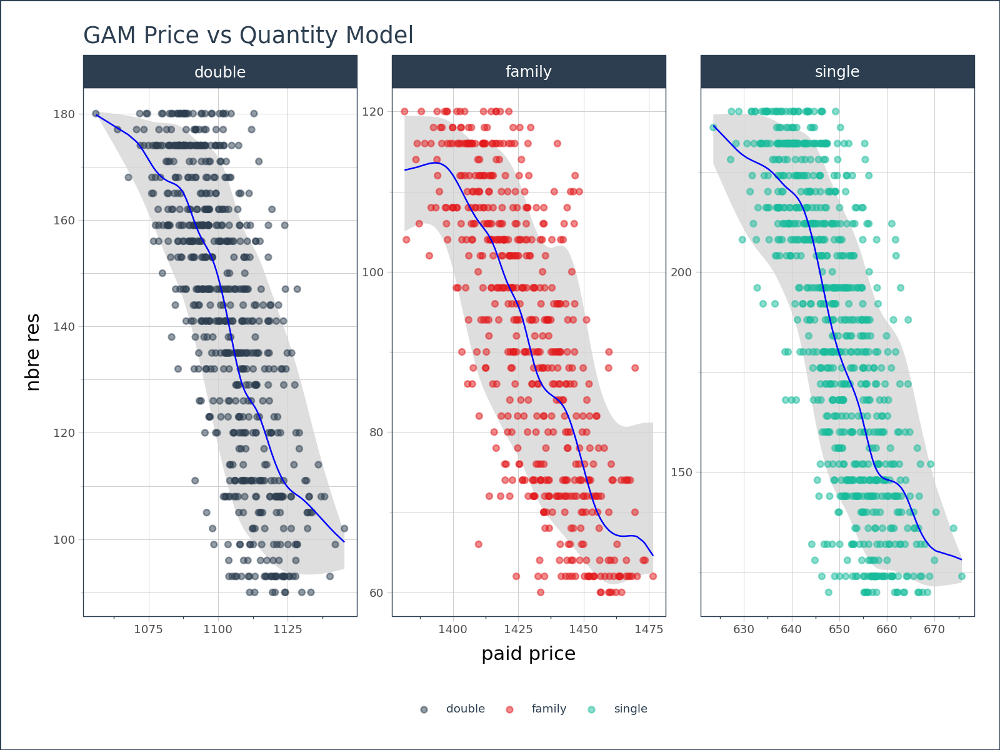

In [291]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [292]:
df_Every_day_pred25 = all_gam_results.copy()

## Event: is_promo

### Booking Lead in [0 , 20]

In [293]:
data_filtered26 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_promo') &
        (df_event['booking lead'] <= 20)
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X26 = data_filtered26[['paid price']]
y26= data_filtered26['nbre res']

print(len(X26)) 

2732


In [294]:
# Create a list of unique products
unique_products = data_filtered26['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [295]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered26[data_filtered26['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
15,2024-01-01,1,672.24,single,144,97643.77,126.197484,149.124635,184.231061
43,2024-01-01,20,658.60,single,144,97643.77,145.198058,179.197460,217.774224
345,2024-01-02,4,664.68,single,148,100141.59,131.951031,166.033315,206.873761
363,2024-01-02,2,673.81,single,148,100141.59,125.766008,145.134638,176.381702
416,2024-01-02,20,650.72,single,148,100141.59,155.423326,195.359020,230.976166
...,...,...,...,...,...,...,...,...,...
267144,2025-06-27,10,1439.70,family,116,171770.48,75.176448,93.526463,111.713828
267906,2025-06-30,7,1462.52,family,70,104947.60,65.737966,81.690605,101.575269
267915,2025-06-30,19,1442.67,family,70,104947.60,74.105078,91.704384,109.971390
267937,2025-06-30,6,1468.10,family,70,104947.60,64.501180,77.846902,96.764855


In [296]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5442,41.13,32.95
1,single,0.500,0.4093,25.44,20.54
2,single,0.975,-0.8197,44.65,37.94
3,double,0.025,-0.4932,29.88,23.96
4,double,0.500,0.4225,18.58,15.11
5,double,0.975,-0.7932,32.74,27.75
6,family,0.025,-0.5731,20.68,16.76
7,family,0.500,0.4115,12.65,10.34
8,family,0.975,-0.7495,21.81,18.48


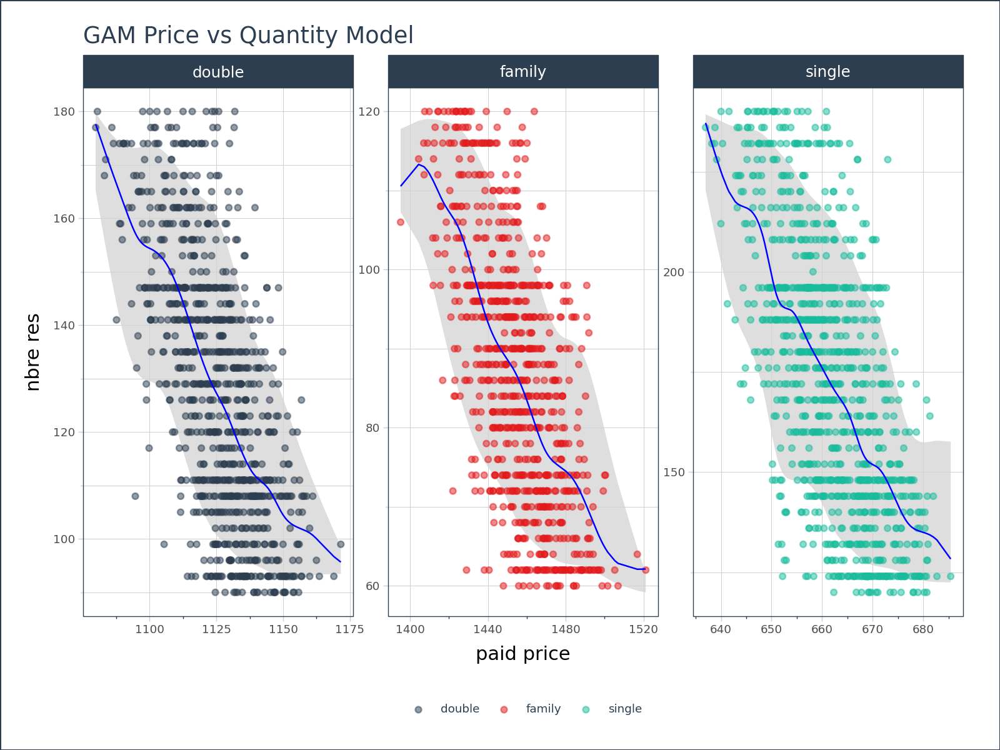

In [297]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [298]:
df_Every_day_pred26 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [299]:
data_filtered27 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_promo') &
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X27 = data_filtered27[['paid price']]
y27= data_filtered27['nbre res']

print(len(X27)) 

2287


In [300]:
# Create a list of unique products
unique_products = data_filtered27['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [301]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered27[data_filtered27['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
10,2024-01-01,22,663.20,single,144,97643.77,122.317788,131.403698,152.432449
16,2024-01-01,34,647.96,single,144,97643.77,130.279215,163.794014,200.525319
50,2024-01-01,27,649.71,single,144,97643.77,128.347478,159.793566,197.745313
75,2024-01-01,29,644.77,single,144,97643.77,137.313326,171.910101,207.992425
80,2024-01-01,21,659.36,single,144,97643.77,124.603270,141.711787,170.944213
...,...,...,...,...,...,...,...,...,...
267921,2025-06-30,28,1436.07,family,70,104947.60,64.174340,79.277566,96.408049
267925,2025-06-30,35,1410.71,family,70,104947.60,75.464042,93.734236,113.454809
267930,2025-06-30,27,1434.33,family,70,104947.60,64.393819,80.275490,97.763116
267950,2025-06-30,25,1439.26,family,70,104947.60,63.714448,77.069862,93.618947


In [302]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.4223,39.57,31.82
1,single,0.500,0.4544,24.51,19.93
2,single,0.975,-0.6365,42.44,35.90
3,double,0.025,-0.5162,30.42,24.69
4,double,0.500,0.4575,18.19,14.57
5,double,0.975,-0.5433,30.69,25.38
6,family,0.025,-0.5368,20.64,16.73
7,family,0.500,0.4256,12.62,10.44
8,family,0.975,-0.6607,21.46,17.96


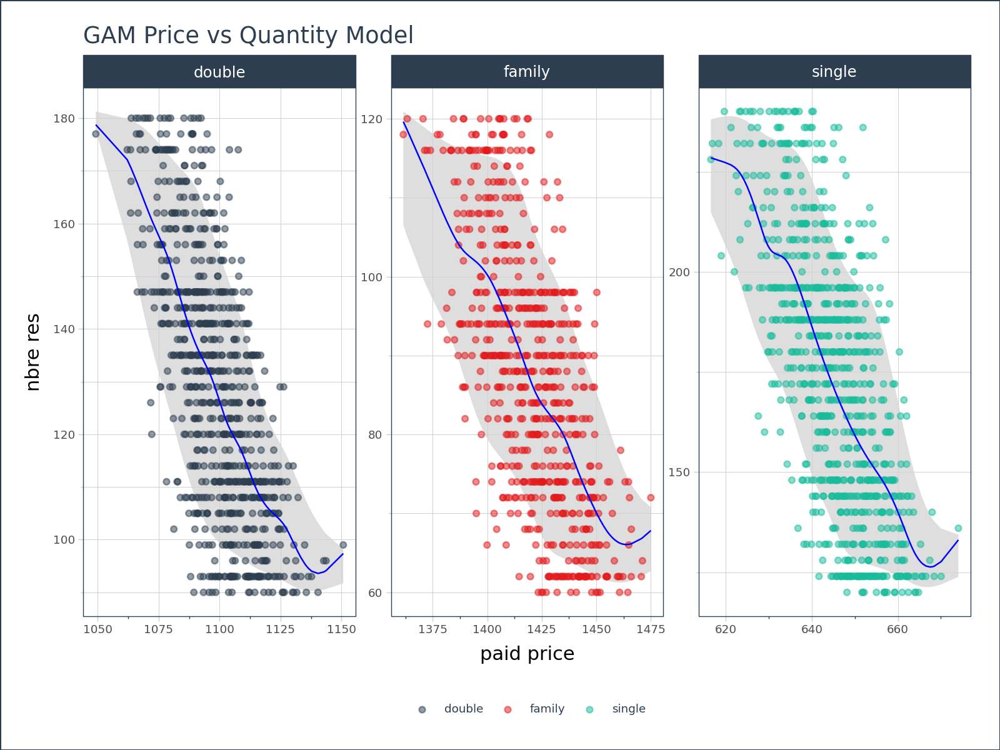

In [303]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [304]:
df_Every_day_pred27 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [305]:
data_filtered28 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_promo') &
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X28 = data_filtered28[['paid price']]
y28= data_filtered28['nbre res']

print(len(X28)) 

1993


In [306]:
# Create a list of unique products
unique_products = data_filtered28['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [307]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered28[data_filtered28['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
3,2024-01-01,49,639.01,single,144,97643.77,125.844812,145.770657,182.286368
35,2024-01-01,55,624.39,single,144,97643.77,141.897306,183.801698,224.245812
45,2024-01-01,48,640.50,single,144,97643.77,124.770366,141.764067,176.024688
66,2024-01-01,59,630.94,single,144,97643.77,133.907069,166.002340,209.533313
69,2024-01-01,45,638.32,single,144,97643.77,126.571327,148.248313,185.753828
...,...,...,...,...,...,...,...,...,...
266195,2025-06-25,52,1352.65,family,114,167528.86,84.939901,103.117921,116.368375
267114,2025-06-27,50,1357.80,family,116,171770.48,80.939002,100.302534,115.079062
267194,2025-06-27,51,1376.21,family,116,171770.48,71.476674,92.389108,110.849073
267952,2025-06-30,50,1405.65,family,70,104947.60,62.563103,74.889908,95.280149


In [308]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5314,41.76,33.68
1,single,0.500,0.4390,25.28,20.06
2,single,0.975,-0.7860,45.10,38.43
3,double,0.025,-0.5512,30.20,24.58
4,double,0.500,0.4222,18.43,14.85
5,double,0.975,-0.7754,32.31,27.46
6,family,0.025,-0.6134,21.40,17.48
7,family,0.500,0.4147,12.89,10.48
8,family,0.975,-0.7122,22.05,18.50


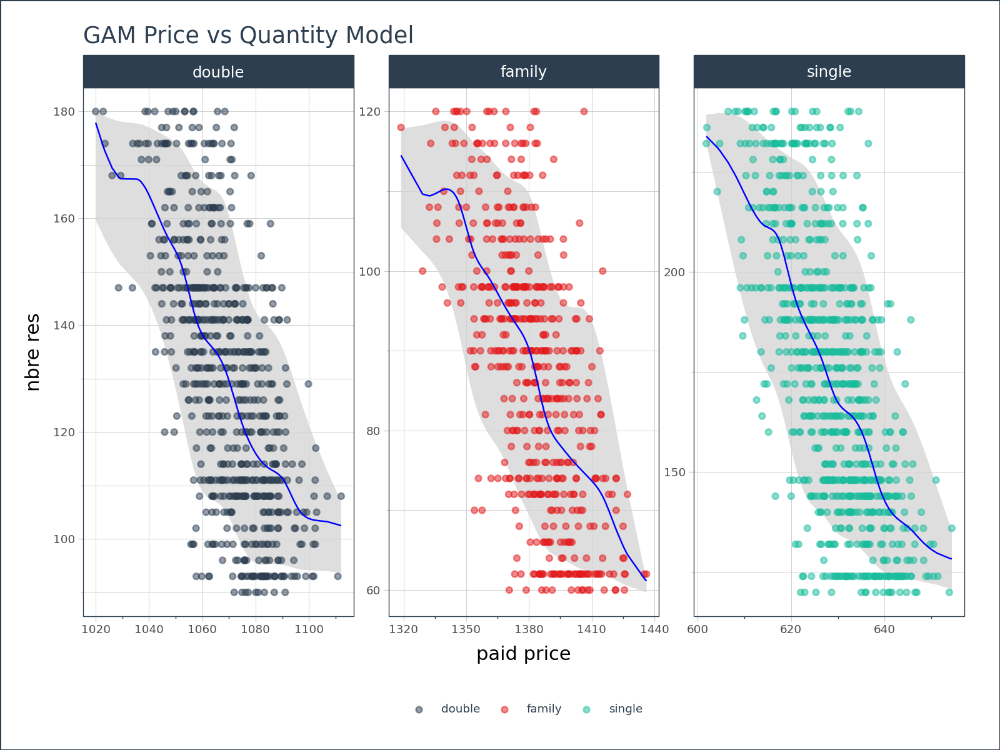

In [309]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [310]:
df_Every_day_pred28 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [311]:
data_filtered29 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_promo') &
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X29 = data_filtered27[['paid price']]
y29= data_filtered27['nbre res']

print(len(X29)) 

2287


In [312]:
# Create a list of unique products
unique_products = data_filtered29['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [313]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered29[data_filtered29['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
29,2024-01-01,79,607.25,single,144,97643.77,151.615123,187.861687,221.610707
42,2024-01-01,72,617.69,single,144,97643.77,132.465316,163.875804,201.516397
76,2024-01-01,75,606.71,single,144,97643.77,153.241536,188.468533,221.664666
97,2024-01-01,61,619.45,single,144,97643.77,130.439356,158.451661,192.281395
135,2024-01-01,63,622.95,single,144,97643.77,126.396007,149.078142,179.288886
...,...,...,...,...,...,...,...,...,...
266608,2025-06-26,67,1340.86,family,110,163298.02,71.612677,92.315743,111.492645
266612,2025-06-26,79,1291.22,family,110,163298.02,104.891200,114.165238,117.781906
267143,2025-06-27,61,1360.68,family,116,171770.48,65.275440,81.676959,101.738178
267910,2025-06-30,61,1371.33,family,70,104947.60,63.869874,76.845786,95.869890


In [314]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.5372,40.09,32.72
1,single,0.500,0.4474,24.03,18.98
2,single,0.975,-0.7123,42.31,35.90
3,double,0.025,-0.4357,30.47,24.52
4,double,0.500,0.4664,18.57,15.03
5,double,0.975,-0.5979,32.14,26.97
6,family,0.025,-0.7419,22.03,18.10
7,family,0.500,0.3653,13.30,10.90
8,family,0.975,-0.8426,22.66,18.95


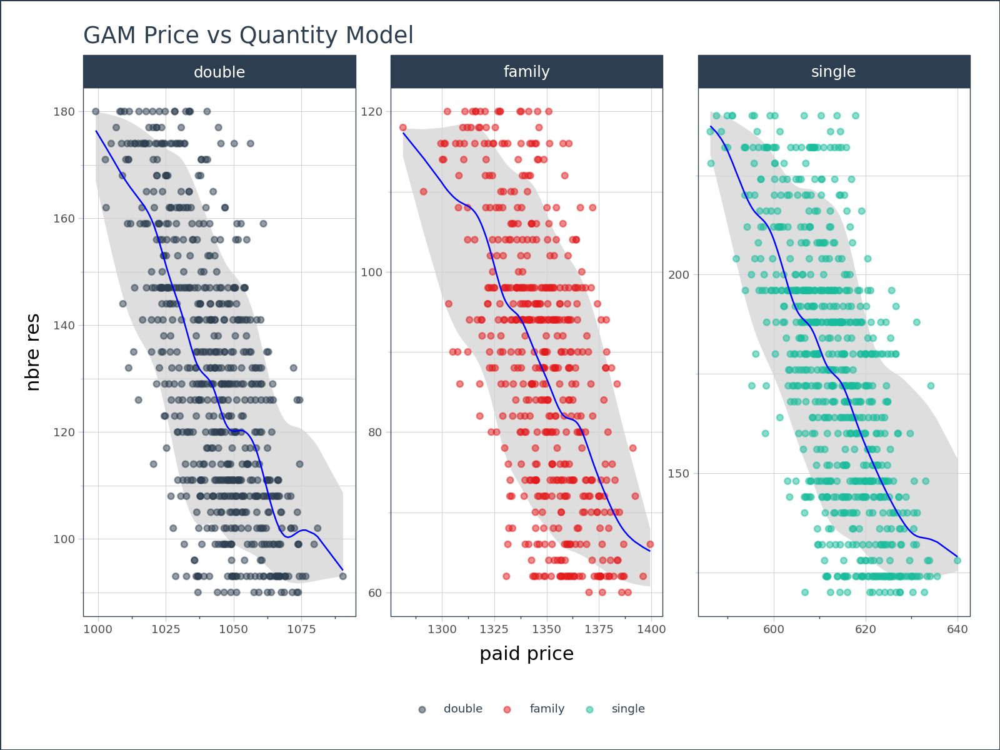

In [315]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [316]:
df_Every_day_pred29 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [317]:
data_filtered30 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_promo') &
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X30 = data_filtered30[['paid price']]
y30= data_filtered30['nbre res']

print(len(X30)) 

994


In [318]:
# Create a list of unique products
unique_products = data_filtered30['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [319]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered30[data_filtered30['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
24,2024-01-01,89,604.46,single,144,97643.77,133.045525,162.136752,191.392155
33,2024-01-01,81,620.97,single,144,97643.77,122.583539,134.803358,174.453219
67,2024-01-01,83,604.27,single,144,97643.77,133.161760,162.407576,191.930003
79,2024-01-01,90,601.23,single,144,97643.77,136.323205,169.362684,202.616107
99,2024-01-01,87,601.03,single,144,97643.77,136.668309,170.036497,203.444748
...,...,...,...,...,...,...,...,...,...
265144,2025-06-23,82,1343.96,family,84,123542.86,62.624616,71.276594,87.308853
266124,2025-06-25,85,1303.08,family,114,167528.86,94.316027,105.089433,117.376991
266654,2025-06-26,86,1308.89,family,110,163298.02,88.254768,100.402778,113.688036
267919,2025-06-30,87,1332.45,family,70,104947.60,65.169788,78.315639,95.645977


In [320]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.3665,37.84,30.98
1,single,0.500,0.5241,22.33,17.99
2,single,0.975,-0.3744,37.95,31.81
3,double,0.025,-0.2427,27.14,22.28
4,double,0.500,0.5596,16.15,12.67
5,double,0.975,-0.3861,28.66,24.54
6,family,0.025,0.0824,16.38,13.21
7,family,0.500,0.6542,10.05,8.04
8,family,0.975,-0.0767,17.74,15.02


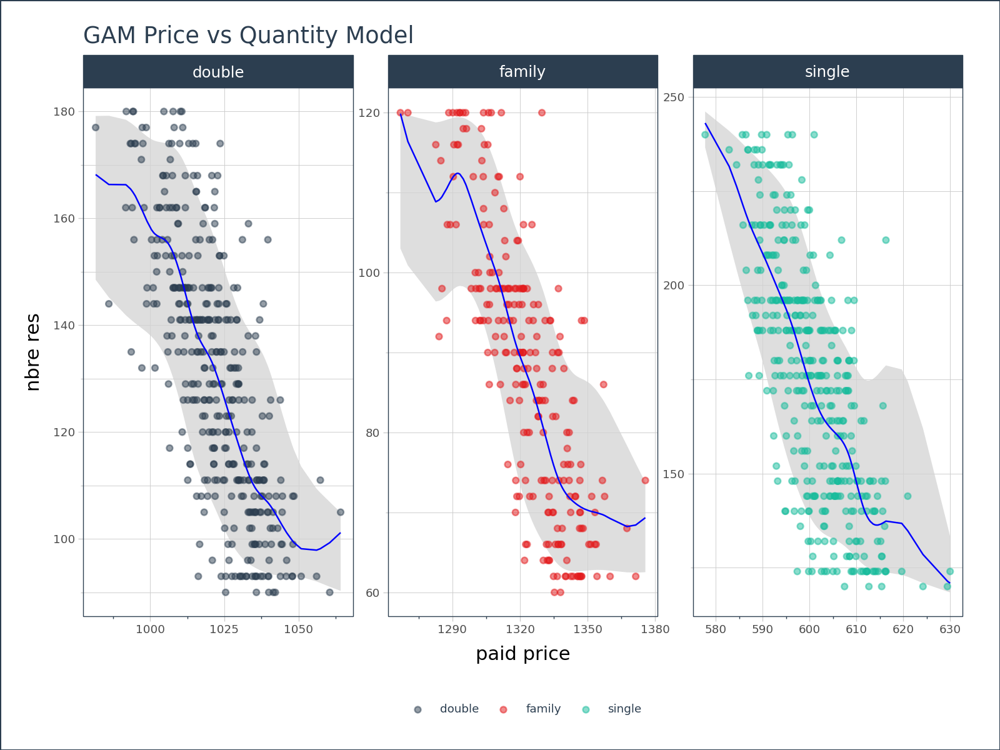

In [321]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [322]:
df_Every_day_pred30 = all_gam_results.copy()

## Event: is_week_end

### Booking Lead in [0 , 20]

In [323]:
data_filtered31 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is-week-end') &
        (df_event['booking lead'] <= 20)
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X31 = data_filtered31[['paid price']]
y31= data_filtered31['nbre res']

print(len(X31)) 

1725


In [324]:
# Create a list of unique products
unique_products = data_filtered31['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [325]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered31[data_filtered31['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
1857,2024-01-06,14,666.22,single,60,38811.1,54.653475,84.369479,110.716560
1861,2024-01-06,12,668.83,single,60,38811.1,51.648524,78.582382,108.499405
1863,2024-01-06,16,669.48,single,60,38811.1,51.023794,77.399881,107.873205
1865,2024-01-06,2,680.18,single,60,38811.1,44.175144,60.397745,88.637500
1868,2024-01-06,0,672.68,single,60,38811.1,48.722555,73.331382,104.416827
...,...,...,...,...,...,...,...,...,...
267624,2025-06-29,11,1453.12,family,44,60351.7,32.335527,46.747952,56.706312
267641,2025-06-29,12,1464.91,family,44,60351.7,25.615579,40.431771,54.170510
267652,2025-06-29,1,1483.90,family,44,60351.7,23.847258,34.378248,49.925297
267653,2025-06-29,3,1479.30,family,44,60351.7,24.761795,36.283385,51.490933


In [326]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-1.0739,33.28,27.38
1,single,0.500,0.2368,20.19,16.64
2,single,0.975,-1.1268,33.70,27.93
3,double,0.025,-0.9857,24.82,20.56
4,double,0.500,0.2853,14.89,12.40
5,double,0.975,-0.9150,24.37,19.93
6,family,0.025,-0.9446,16.50,13.50
7,family,0.500,0.2856,10.00,8.25
8,family,0.975,-0.9856,16.67,13.75


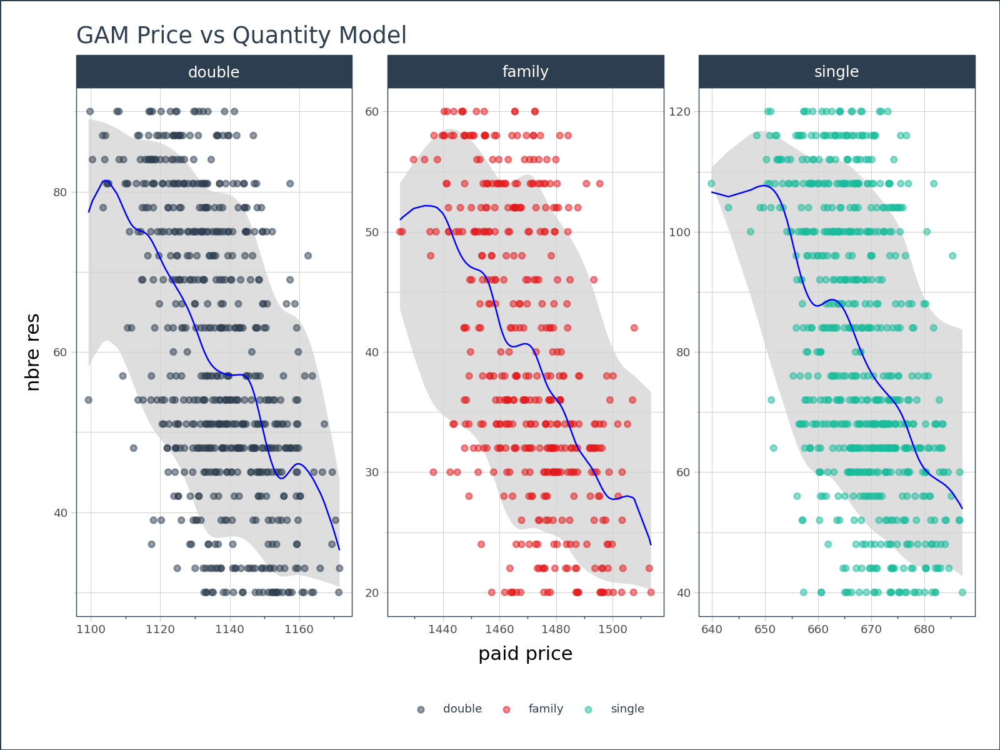

In [327]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [328]:
df_Every_day_pred31 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [329]:
data_filtered32 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is-week-end') &
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X32 = data_filtered32[['paid price']]
y32= data_filtered32['nbre res']

print(len(X32)) 

1336


In [330]:
# Create a list of unique products
unique_products = data_filtered32['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [331]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered32[data_filtered32['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
1856,2024-01-06,35,648.16,single,60,38811.10,56.663052,85.002672,112.641911
1858,2024-01-06,24,654.80,single,60,38811.10,48.567602,72.410034,103.010500
1859,2024-01-06,27,665.00,single,60,38811.10,45.085043,60.461084,82.283289
1869,2024-01-06,39,649.08,single,60,38811.10,55.444005,84.233754,112.876751
1873,2024-01-06,40,650.17,single,60,38811.10,53.919195,83.463216,112.673987
...,...,...,...,...,...,...,...,...,...
267461,2025-06-28,24,1449.76,family,54,73911.57,24.514270,35.086873,49.338325
267621,2025-06-29,24,1425.36,family,44,60351.70,30.665791,43.629671,55.167604
267628,2025-06-29,25,1444.45,family,44,60351.70,24.543078,36.829220,50.503622
267646,2025-06-29,34,1410.29,family,44,60351.70,33.607528,49.635556,58.093061


In [332]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.8287,31.85,25.51
1,single,0.500,0.2742,20.07,16.39
2,single,0.975,-1.1082,34.20,28.44
3,double,0.025,-0.8006,23.32,19.22
4,double,0.500,0.3557,13.95,11.59
5,double,0.975,-0.6345,22.22,17.83
6,family,0.025,-0.9284,15.76,13.09
7,family,0.500,0.3200,9.36,7.72
8,family,0.975,-0.8891,15.60,12.84


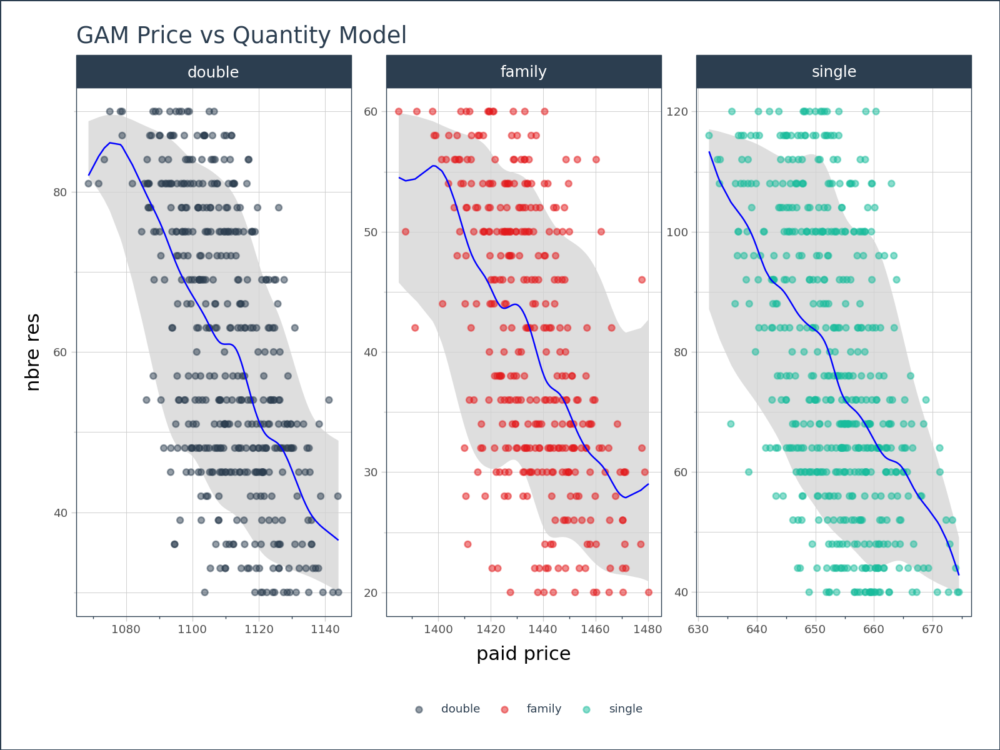

In [333]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [334]:
df_Every_day_pred32 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [335]:
data_filtered33 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is-week-end') &
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X33 = data_filtered33[['paid price']]
y33= data_filtered33['nbre res']

print(len(X33)) 

1102


In [336]:
# Create a list of unique products
unique_products = data_filtered33['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [337]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered33[data_filtered33['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
1860,2024-01-06,55,631.78,single,60,38811.10,55.009924,83.459326,112.200041
1862,2024-01-06,58,635.70,single,60,38811.10,51.586164,79.111447,108.482773
1867,2024-01-06,59,625.08,single,60,38811.10,67.802388,96.054524,115.396004
1883,2024-01-06,53,638.44,single,60,38811.10,48.317622,74.907222,104.933070
1886,2024-01-06,57,635.33,single,60,38811.10,51.946089,79.412405,108.925227
...,...,...,...,...,...,...,...,...,...
267425,2025-06-28,49,1385.19,family,54,73911.57,30.058624,46.292957,56.062018
267433,2025-06-28,59,1380.92,family,54,73911.57,30.571176,46.945807,56.647572
267438,2025-06-28,58,1367.65,family,54,73911.57,39.630895,50.186764,58.178788
267623,2025-06-29,44,1410.07,family,44,60351.70,25.380940,38.985677,51.530129


In [338]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.9658,33.55,27.37
1,single,0.500,0.2663,20.50,17.23
2,single,0.975,-0.9473,33.39,26.96
3,double,0.025,-0.9583,24.26,19.98
4,double,0.500,0.2957,14.55,11.99
5,double,0.975,-0.9773,24.37,20.25
6,family,0.025,-0.9191,16.05,12.99
7,family,0.500,0.2741,9.87,8.12
8,family,0.975,-1.0384,16.54,13.48


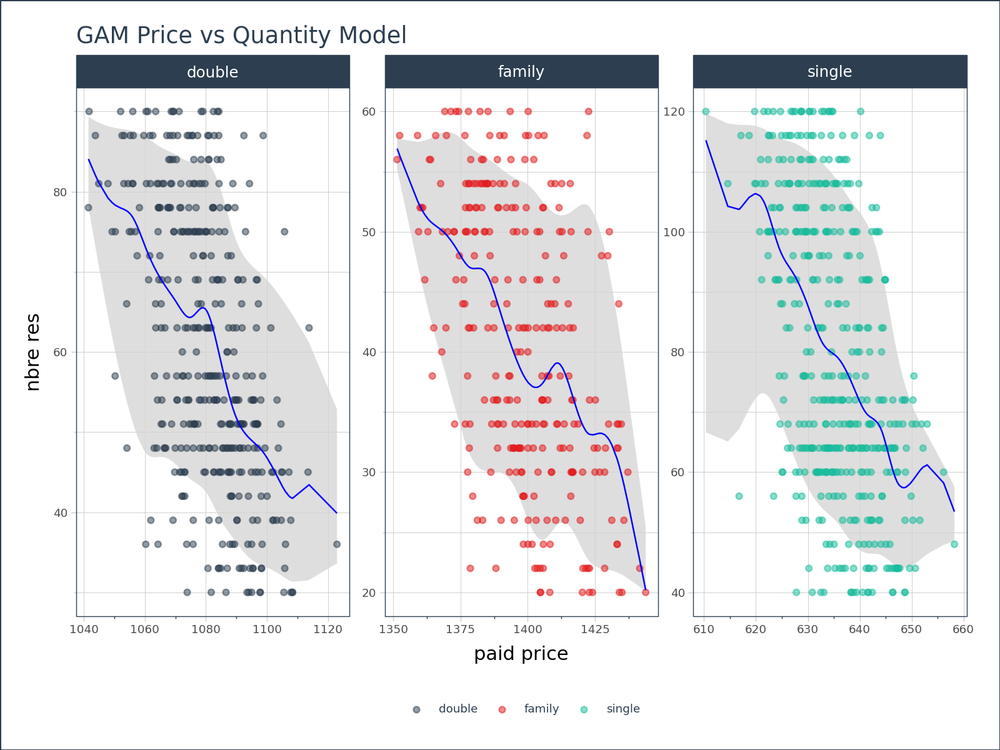

In [339]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [340]:
df_Every_day_pred33 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [341]:
data_filtered34 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is-week-end') &
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X34 = data_filtered34[['paid price']]
y34= data_filtered34['nbre res']

print(len(X34)) 

1022


In [342]:
# Create a list of unique products
unique_products = data_filtered34['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [343]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered34[data_filtered34['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
1854,2024-01-06,75,616.64,single,60,38811.10,56.140743,84.909702,110.678296
1866,2024-01-06,73,623.50,single,60,38811.10,49.777313,76.874008,105.656782
1870,2024-01-06,65,627.11,single,60,38811.10,47.138813,65.650894,93.881835
1878,2024-01-06,61,631.83,single,60,38811.10,43.027149,61.767752,89.653737
1889,2024-01-06,78,622.41,single,60,38811.10,50.198859,79.080293,108.711519
...,...,...,...,...,...,...,...,...,...
267440,2025-06-28,77,1355.05,family,54,73911.57,27.829703,39.849422,52.697899
267443,2025-06-28,75,1339.12,family,54,73911.57,33.248580,48.862034,57.138616
267455,2025-06-28,62,1370.53,family,54,73911.57,25.943709,37.101734,51.983275
267616,2025-06-29,68,1384.75,family,44,60351.70,22.637118,33.617991,48.850735


In [344]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.9651,32.95,26.92
1,single,0.500,0.2669,20.12,16.65
2,single,0.975,-0.9941,33.19,27.28
3,double,0.025,-0.8728,23.35,19.24
4,double,0.500,0.3073,14.20,11.71
5,double,0.975,-0.9175,23.63,19.52
6,family,0.025,-1.0520,16.15,13.26
7,family,0.500,0.2479,9.78,8.18
8,family,0.975,-1.0046,15.96,12.93


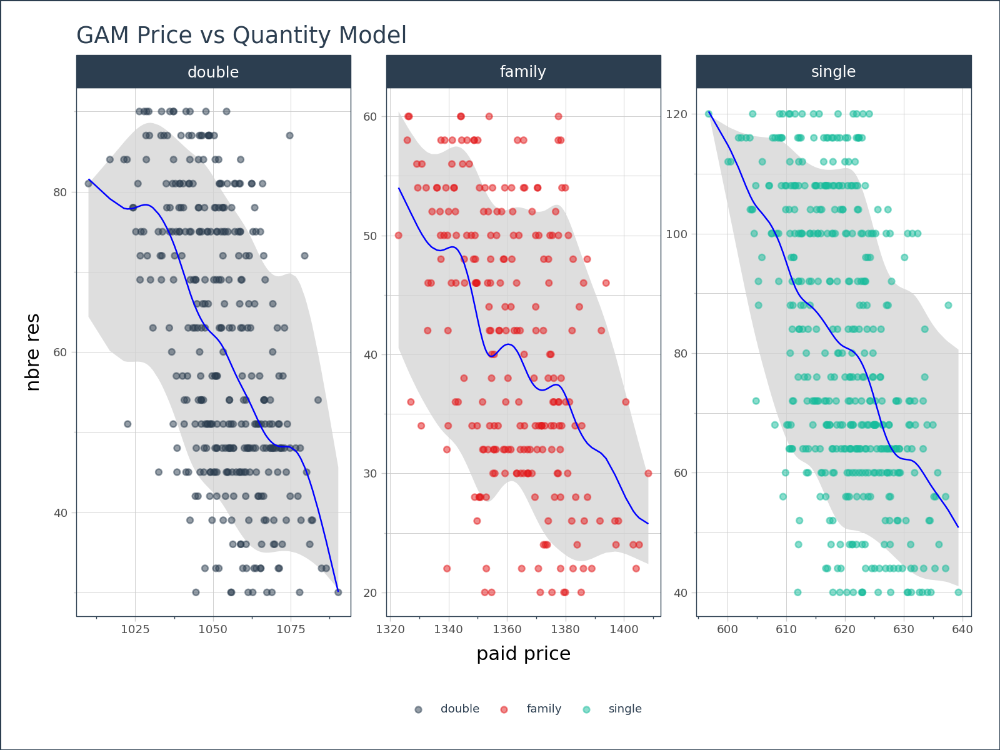

In [345]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [346]:
df_Every_day_pred34 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [394]:
data_filtered35 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is-week-end') &
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X35 = data_filtered35[['paid price']]
y35= data_filtered35['nbre res']

print(len(X35))  

545


In [395]:
# Create a list of unique products
unique_products = data_filtered35['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [396]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered35[data_filtered35['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
1855,2024-01-06,86,603.50,single,60,38811.10,63.690268,89.984349,113.354154
1864,2024-01-06,82,621.38,single,60,38811.10,43.603847,55.745006,78.611052
1880,2024-01-06,81,611.56,single,60,38811.10,48.601459,67.943966,92.403794
1892,2024-01-06,89,605.30,single,60,38811.10,60.941243,88.197265,113.643116
1894,2024-01-06,83,621.24,single,60,38811.10,43.710559,55.407218,78.613577
...,...,...,...,...,...,...,...,...,...
267415,2025-06-28,87,1345.83,family,54,73911.57,25.841526,37.488128,50.790629
267427,2025-06-28,82,1343.43,family,54,73911.57,26.382264,38.371777,51.645967
267453,2025-06-28,90,1314.35,family,54,73911.57,34.151565,51.649127,57.860635
267620,2025-06-29,89,1321.98,family,44,60351.70,28.775956,46.883284,57.580132


In [397]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-0.6641,29.72,24.33
1,single,0.500,0.3835,18.09,15.26
2,single,0.975,-0.6748,29.82,24.40
3,double,0.025,-0.3246,21.04,16.99
4,double,0.500,0.4956,12.99,10.77
5,double,0.975,-0.4609,22.10,17.53
6,family,0.025,-0.8708,15.53,12.70
7,family,0.500,0.4294,8.58,6.73
8,family,0.975,-0.6793,14.71,12.10


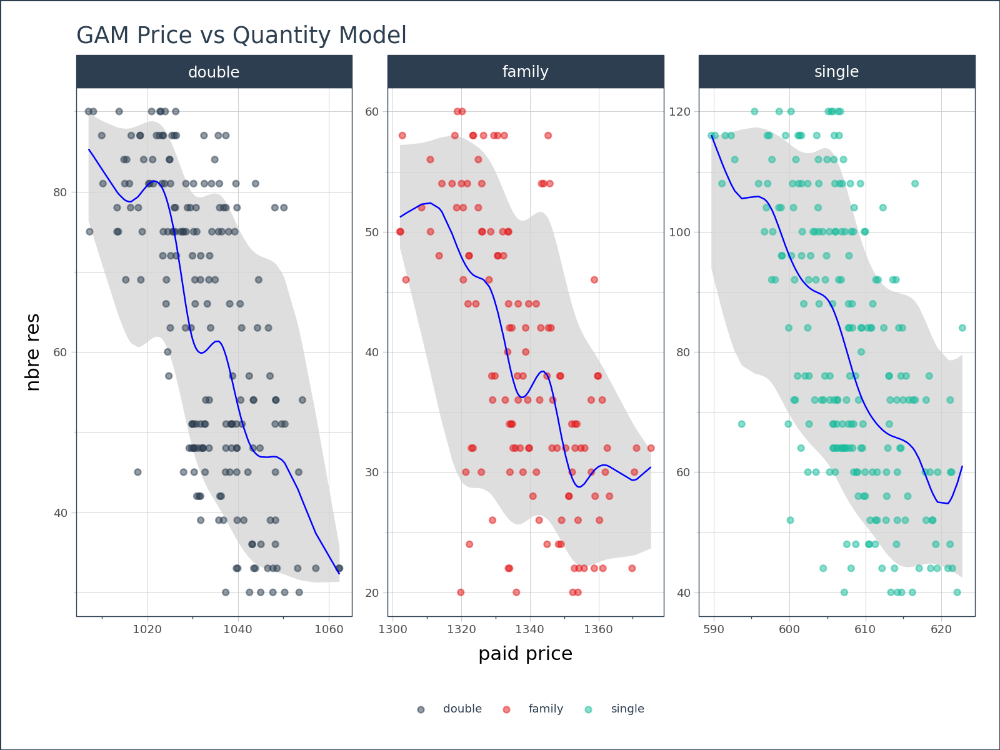

In [398]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [399]:
df_Every_day_pred35 = all_gam_results.copy()

## Event: is_week_end_promo

### Booking Lead in [0 , 20]

In [353]:
data_filtered36 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_week_end_promo') &
        (df_event['booking lead'] <= 20)
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X36 = data_filtered36[['paid price']]
y36= data_filtered36['nbre res']

print(len(X36)) 

524


In [354]:
# Create a list of unique products
unique_products = data_filtered36['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [355]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered36[data_filtered36['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
4011,2024-01-13,19,604.56,single,92,57298.82,91.367549,107.055599,118.367303
4014,2024-01-13,14,605.92,single,92,57298.82,90.782105,106.117729,118.097204
4016,2024-01-13,9,624.87,single,92,57298.82,84.033655,96.604447,113.414483
4020,2024-01-13,11,627.61,single,92,57298.82,84.347510,96.057262,113.711609
4038,2024-01-13,16,599.90,single,92,57298.82,90.531485,102.885464,113.816796
...,...,...,...,...,...,...,...,...,...
267631,2025-06-29,18,1344.09,family,44,60351.70,43.597631,51.825788,58.797325
267637,2025-06-29,14,1335.07,family,44,60351.70,45.139935,51.592984,57.668472
267638,2025-06-29,13,1350.78,family,44,60351.70,43.908002,51.920443,58.532636
267640,2025-06-29,17,1357.66,family,44,60351.70,43.396268,49.957994,57.396752


In [356]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-1.3964,17.32,14.25
1,single,0.500,0.0956,10.64,8.82
2,single,0.975,-1.5194,17.76,14.79
3,double,0.025,-1.2192,13.38,10.77
4,double,0.500,0.1418,8.32,6.87
5,double,0.975,-1.2534,13.48,10.99
6,family,0.025,-1.3464,8.70,7.09
7,family,0.500,0.1262,5.31,4.46
8,family,0.975,-1.2241,8.48,6.83


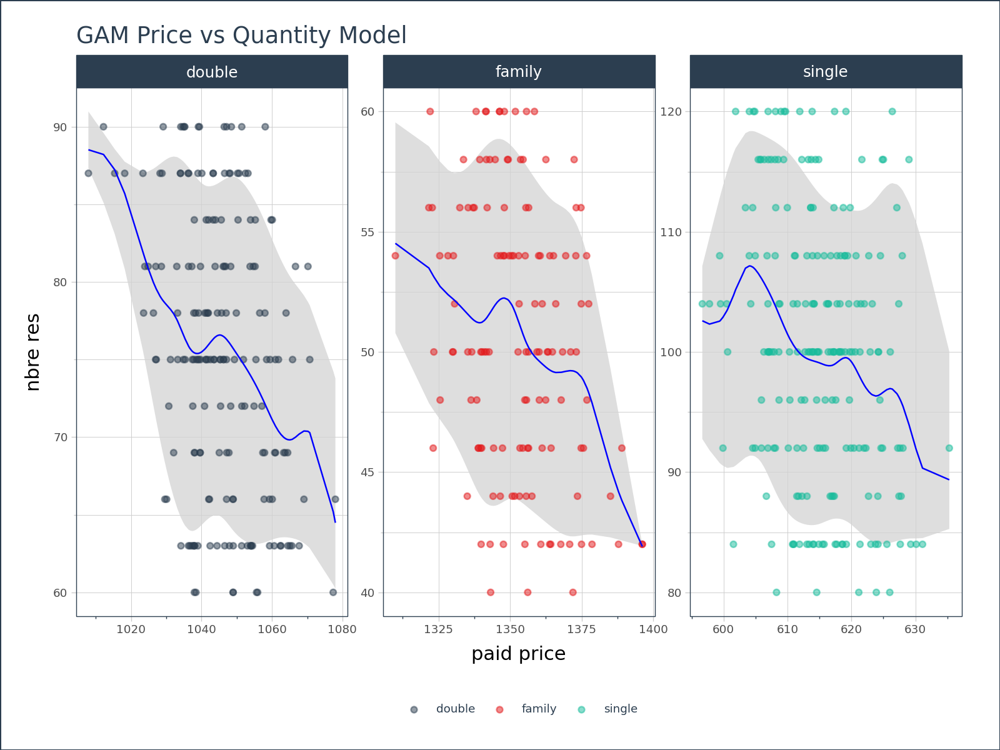

In [357]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [358]:
df_Every_day_pred36 = all_gam_results.copy()

### Booking Lead in ]20 , 40]

In [359]:
data_filtered37 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_week_end_promo') &
        ((df_event['booking lead'] > 20) & (df_event['booking lead'] <= 40))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X37 = data_filtered37[['paid price']]
y37= data_filtered37['nbre res']

print(len(X37)) 

457


In [360]:
# Create a list of unique products
unique_products = data_filtered37['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [361]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered37[data_filtered37['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
4022,2024-01-13,27,604.52,single,92,57298.82,86.719541,100.641782,115.097020
4029,2024-01-13,29,598.69,single,92,57298.82,86.397647,99.301366,111.857894
4039,2024-01-13,28,606.62,single,92,57298.82,86.871030,103.537245,115.873179
4045,2024-01-13,30,594.68,single,92,57298.82,88.397870,104.141413,116.005000
4085,2024-01-13,23,602.25,single,92,57298.82,86.751600,99.234257,113.144544
...,...,...,...,...,...,...,...,...,...
267414,2025-06-28,25,1323.04,family,54,73911.57,42.489223,50.370472,57.747646
267437,2025-06-28,23,1334.61,family,54,73911.57,41.501127,46.470508,54.576630
267634,2025-06-29,29,1321.65,family,44,60351.70,42.547071,50.057450,57.591062
267635,2025-06-29,23,1332.19,family,44,60351.70,41.858398,47.936700,55.604802


In [362]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-1.6261,17.76,14.99
1,single,0.500,0.1030,10.38,8.65
2,single,0.975,-1.2883,16.58,13.45
3,double,0.025,-1.4226,14.36,11.81
4,double,0.500,0.1124,8.69,7.26
5,double,0.975,-1.2830,13.94,11.21
6,family,0.025,-1.3050,9.14,7.51
7,family,0.500,0.1916,5.41,4.50
8,family,0.975,-1.1117,8.74,7.09


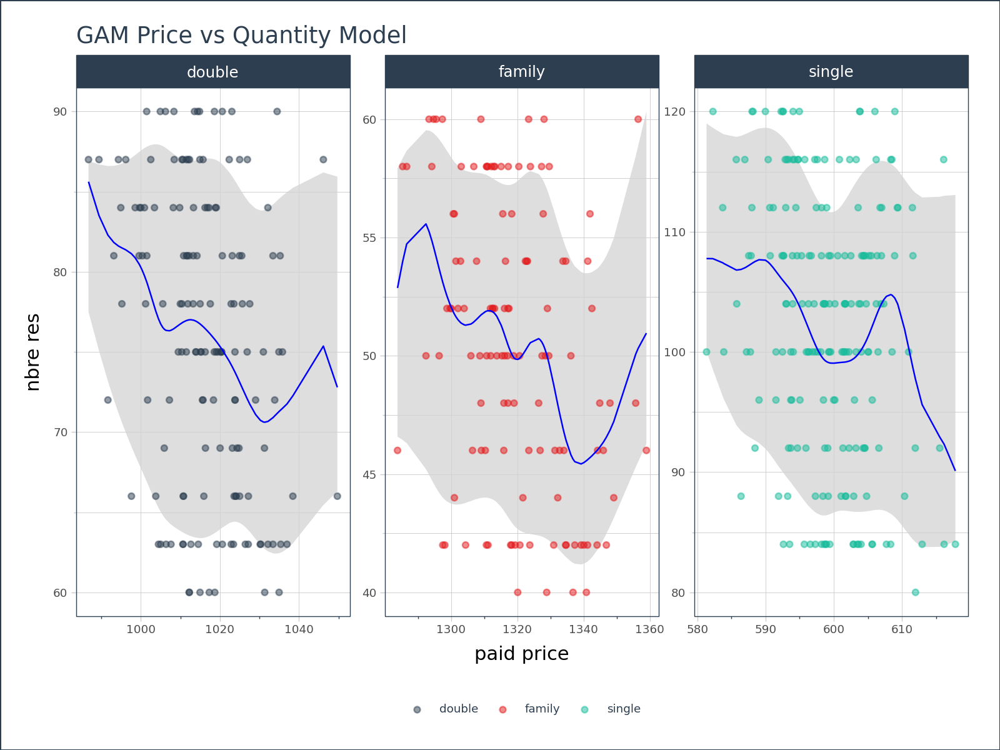

In [363]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [364]:
df_Every_day_pred37 = all_gam_results.copy()

### Booking Lead in ]40 , 60]

In [365]:
data_filtered38 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_week_end_promo') &
        ((df_event['booking lead'] > 40) & (df_event['booking lead'] <= 60))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X38 = data_filtered38[['paid price']]
y38= data_filtered38['nbre res']

print(len(X38)) 

328


In [366]:
# Create a list of unique products
unique_products = data_filtered38['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [367]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered38[data_filtered38['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
4081,2024-01-13,55,575.49,single,92,57298.82,85.370312,100.637648,114.850872
4227,2024-01-14,46,591.17,single,92,57050.71,85.134358,95.794168,112.152557
4243,2024-01-14,47,590.62,single,92,57050.71,85.234138,95.808588,112.280574
4257,2024-01-14,48,582.07,single,92,57050.71,84.866623,99.682152,115.618979
4270,2024-01-14,42,588.97,single,92,57050.71,86.075203,97.924258,112.361458
...,...,...,...,...,...,...,...,...,...
267460,2025-06-28,46,1287.55,family,54,73911.57,42.435255,50.230049,56.857699
267625,2025-06-29,51,1272.17,family,44,60351.70,44.986916,51.895869,58.887442
267632,2025-06-29,48,1296.86,family,44,60351.70,41.271173,46.664446,53.406626
267639,2025-06-29,49,1288.45,family,44,60351.70,42.208149,49.843823,56.628103


In [368]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-1.4980,17.90,14.83
1,single,0.500,0.0939,10.78,8.88
2,single,0.975,-1.4024,17.55,14.35
3,double,0.025,-1.4957,13.34,11.01
4,double,0.500,0.1000,8.01,6.52
5,double,0.975,-1.4178,13.13,10.75
6,family,0.025,-1.3512,8.45,7.03
7,family,0.500,0.1699,5.02,4.22
8,family,0.975,-1.1809,8.14,6.62


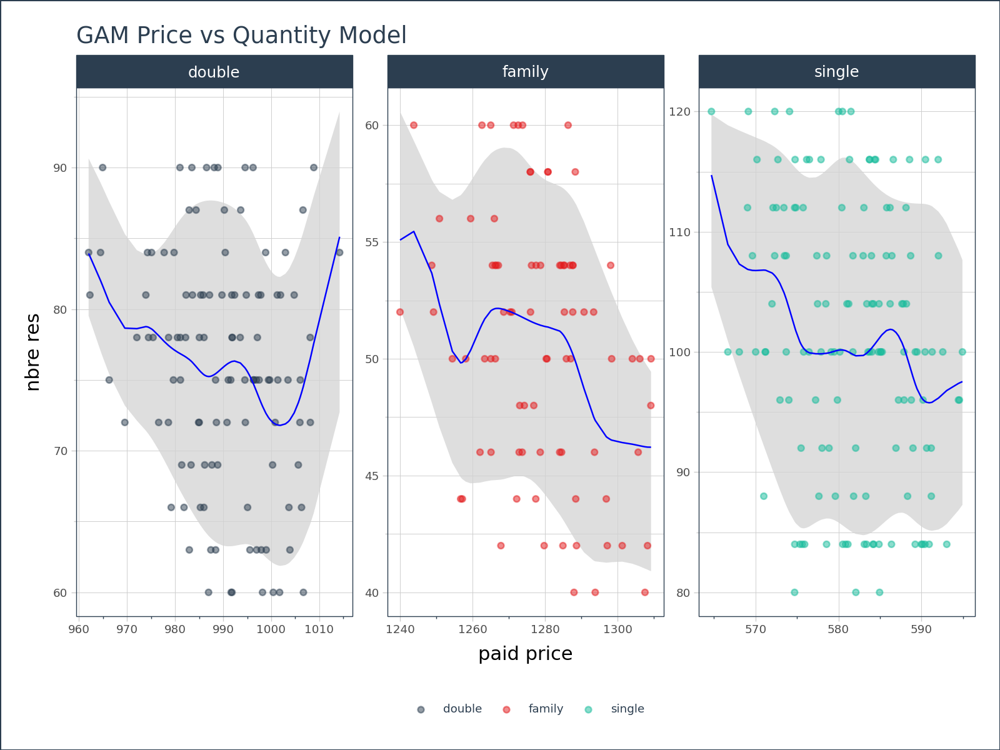

In [369]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [371]:
df_Every_day_pred38 = all_gam_results.copy()

### Booking Lead in ]60 , 80]

In [372]:
data_filtered39 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_week_end_promo') &
        ((df_event['booking lead'] > 60) & (df_event['booking lead'] <= 80))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X39 = data_filtered39[['paid price']]
y39= data_filtered39['nbre res']

print(len(X39)) 

371


In [373]:
# Create a list of unique products
unique_products = data_filtered39['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [374]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered39[data_filtered39['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
4007,2024-01-13,61,570.36,single,92,57298.82,85.400261,99.475995,113.284771
4010,2024-01-13,73,556.48,single,92,57298.82,87.342736,105.170010,118.088786
4028,2024-01-13,66,560.56,single,92,57298.82,88.580267,105.428354,118.516854
4040,2024-01-13,71,563.58,single,92,57298.82,87.885919,104.652834,118.052925
4094,2024-01-13,63,582.35,single,92,57298.82,83.779175,92.720014,105.367045
...,...,...,...,...,...,...,...,...,...
264738,2025-06-21,76,1239.52,family,50,67725.29,46.245909,52.429239,57.793543
264741,2025-06-21,73,1239.96,family,50,67725.29,46.001621,52.311400,57.722346
267432,2025-06-28,71,1245.09,family,54,73911.57,43.141295,49.883516,56.425451
267441,2025-06-28,69,1237.70,family,54,73911.57,47.135895,52.778578,58.047840


In [375]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-1.6072,18.97,16.00
1,single,0.500,0.1301,10.96,9.14
2,single,0.975,-1.1118,17.08,13.62
3,double,0.025,-1.4202,13.26,10.92
4,double,0.500,0.1287,7.96,6.68
5,double,0.975,-1.1767,12.58,9.98
6,family,0.025,-1.0804,7.89,6.51
7,family,0.500,0.2294,4.80,4.04
8,family,0.975,-1.0580,7.85,6.38


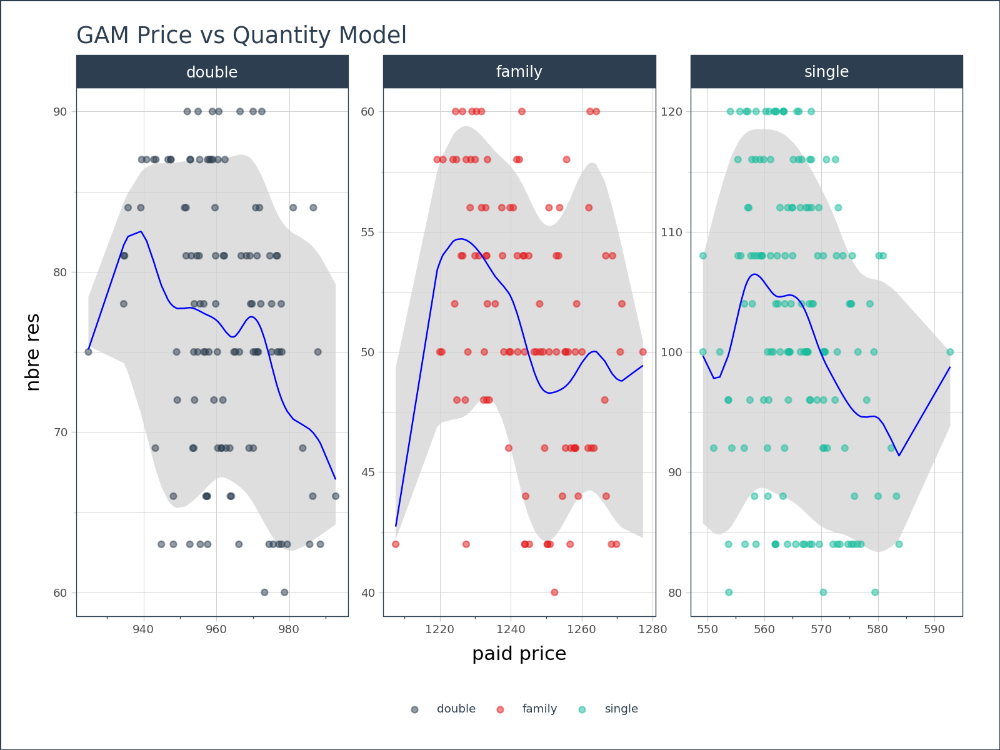

In [376]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [377]:
df_Every_day_pred39 = all_gam_results.copy()

### Booking Lead in ]80 , 100]

In [378]:
data_filtered40 = (
    df_event[
        (df_event['arr month'].isin([6, 7, 8, 12, 1])) &
        #(df['is-week-end'] == False) &
        (df_event['event'] == 'is_week_end_promo') &
        ((df_event['booking lead'] > 80) & (df_event['booking lead'] <= 100))
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre', 'booking lead'], keep='first')
)


X40 = data_filtered40[['paid price']]
y40= data_filtered40['nbre res']

print(len(X40)) 

179


In [379]:
# Create a list of unique products
unique_products = data_filtered40['type de chambre'].unique()
unique_products

array(['single', 'double', 'family'], dtype=object)

In [380]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# Create an empty dataframe to store the concatenated results
all_gam_results = pd.DataFrame()
# Create a list to store all metrics
metrics_list = []

# Loop through each product
for product in unique_products:
    # Filter data for the current product
    product_data = data_filtered40[data_filtered40['type de chambre'] == product]

    X = product_data[['paid price']]
    y = product_data['nbre res']

    quantiles = [0.025, 0.5, 0.975]

    # Fit the GAM model for the filtered data
    gam_results = {}
    for q in quantiles:
        gam = ExpectileGAM(lam=0.5, expectile=q)
        gam.fit(X, y)
        y_pred = gam.predict(X)
        gam_results[f"pred_q{q}"] = y_pred

        # Compute metrics
        r2 = r2_score(y, y_pred)
        rmse = np.sqrt(mean_squared_error(y, y_pred)) 
        mae = mean_absolute_error(y, y_pred)

        # Store in list
        metrics_list.append({
            'product': product,
            'quantile': q,
            'r2_score': round(r2, 4),
            'rmse': round(rmse, 2),
            'mae': round(mae, 2)
        })

    # Store the results in a dataframe with index that matches the original data
    predictions_gam = pd.DataFrame(gam_results).set_index(X.index)

    # Concatenate the results column-wise with the original data
    predictions_gam_df = pd.concat([product_data[['arrival day', 'booking lead', 'paid price', 'type de chambre', 'nbre res', 'rev par type de chambre']], predictions_gam], axis=1)

    # Concatenate results row-wise
    all_gam_results = pd.concat([all_gam_results, predictions_gam_df], axis=0)

# Create a metrics dataframe
metrics_df = pd.DataFrame(metrics_list)
all_gam_results

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
4035,2024-01-13,87,554.49,single,92,57298.82,89.419562,101.167632,113.472889
4222,2024-01-14,81,560.76,single,92,57050.71,85.640698,98.287229,110.009188
4228,2024-01-14,87,565.93,single,92,57050.71,80.824006,88.980285,104.473003
4241,2024-01-14,88,546.54,single,92,57050.71,94.043942,106.035629,116.825748
4275,2024-01-14,85,563.95,single,92,57050.71,82.213818,94.051724,108.524909
...,...,...,...,...,...,...,...,...,...
260499,2025-06-08,86,1217.55,family,60,81900.67,46.859862,53.337066,58.141856
262763,2025-06-15,85,1236.29,family,50,68017.79,42.391842,47.566125,53.886716
262777,2025-06-15,81,1221.75,family,50,68017.79,45.290212,52.858679,57.957525
264705,2025-06-21,84,1215.48,family,50,67725.29,47.345071,53.382759,58.065309


In [381]:
metrics_df

,product,quantile,r2_score,rmse,mae
0,single,0.025,-1.0701,15.05,12.45
1,single,0.500,0.3074,8.71,7.13
2,single,0.975,-0.8235,14.13,11.34
3,double,0.025,-0.5535,10.98,8.15
4,double,0.500,0.3085,7.33,5.94
5,double,0.975,-1.2999,13.36,11.21
6,family,0.025,-1.1612,7.45,6.36
7,family,0.500,0.3654,4.04,3.29
8,family,0.975,-0.4840,6.17,4.71


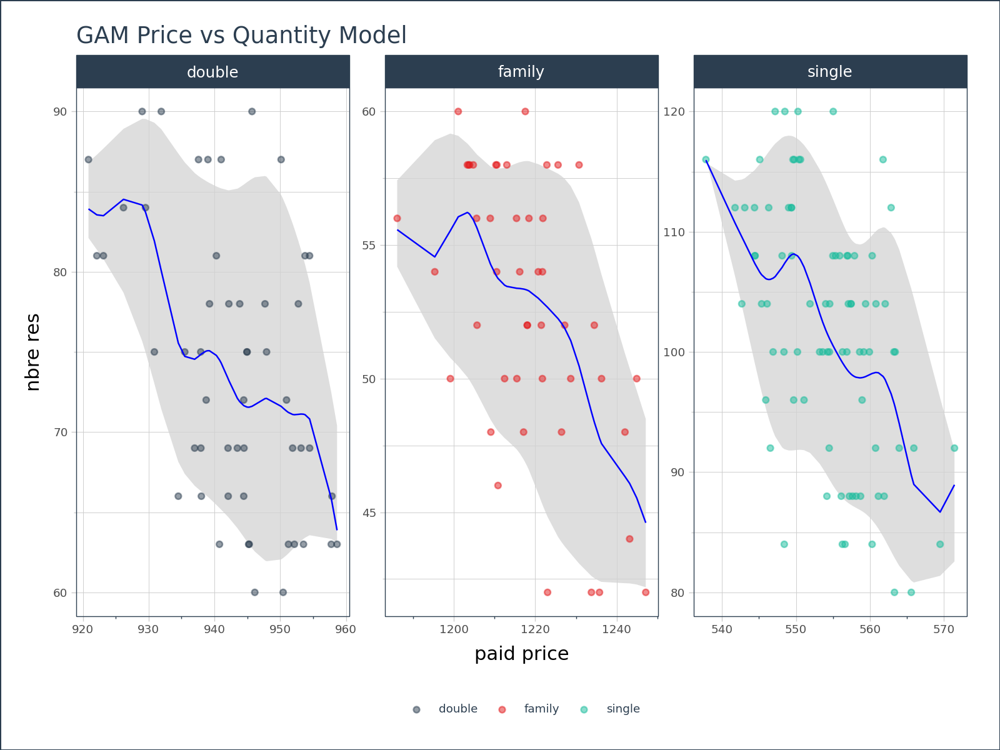

In [382]:
# Visualize the GAM Price Model Results
ggplot(
         data = all_gam_results,
         mapping = aes(x='paid price', y='nbre res', color='type de chambre', group='type de chambre'),
    ) + \
    geom_ribbon(aes(ymax='pred_q0.975', ymin='pred_q0.025'), fill='#d3d3d3', color='#FF000000', alpha=0.75, show_legend=False) + \
    geom_point(alpha=0.5) + \
    geom_line(aes(y='pred_q0.5'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(title='GAM Price vs Quantity Model') + \
    scale_color_manual(values=list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)

In [383]:
df_Every_day_pred40 = all_gam_results.copy()

## concaténation

In [400]:
# Liste contenant tous les DataFrames
all_dfs_2 = [
    df_Every_day_pred21,
    df_Every_day_pred22,
    df_Every_day_pred23,
    df_Every_day_pred24,
    df_Every_day_pred25,
    df_Every_day_pred26,
    df_Every_day_pred27,
    df_Every_day_pred28,
    df_Every_day_pred29,
    df_Every_day_pred30,
    df_Every_day_pred31,
    df_Every_day_pred32,
    df_Every_day_pred33,
    df_Every_day_pred34,
    df_Every_day_pred35,
    df_Every_day_pred36,
    df_Every_day_pred37,
    df_Every_day_pred38,
    df_Every_day_pred39,
    df_Every_day_pred40
]

# Concaténer sans réinitialiser l’index
df_all_2 = pd.concat(all_dfs_2, axis=0)

# Optionnel : vérifier les dimensions
print(df_all_2.shape)


(37826, 9)


In [387]:
df_all_2

,arrival day,booking lead,paid price,type de chambre,nbre res,rev par type de chambre,pred_q0.025,pred_q0.5,pred_q0.975
0,2024-01-01,2,728.13,single,144,97643.77,124.368396,139.183923,166.975651
4,2024-01-01,0,722.32,single,144,97643.77,126.174469,148.988993,187.222608
11,2024-01-01,5,720.21,single,144,97643.77,126.896706,154.161935,194.082516
17,2024-01-01,3,723.45,single,144,97643.77,125.821179,146.349469,183.692557
18,2024-01-01,18,710.50,single,144,97643.77,139.372864,181.864880,222.869680
...,...,...,...,...,...,...,...,...,...
260499,2025-06-08,86,1217.55,family,60,81900.67,46.859862,53.337066,58.141856
262763,2025-06-15,85,1236.29,family,50,68017.79,42.391842,47.566125,53.886716
262777,2025-06-15,81,1221.75,family,50,68017.79,45.290212,52.858679,57.957525
264705,2025-06-21,84,1215.48,family,50,67725.29,47.345071,53.382759,58.065309


In [389]:
df_event

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,nbre res,paid price,rev par type de chambre,event,pred_q0.025,pred_q0.5,pred_q0.975
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,144,728.13,97643.77,no_promo,NaN,NaN,NaN
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,144,676.01,97643.77,no_promo,NaN,NaN,NaN
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,144,667.57,97643.77,no_promo,NaN,NaN,NaN
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,144,639.01,97643.77,is_promo,NaN,NaN,NaN
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,144,722.32,97643.77,no_promo,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,70,1465.57,104947.60,no_promo,NaN,NaN,NaN
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,70,1592.27,104947.60,no_promo,NaN,NaN,NaN
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,70,1468.10,104947.60,is_promo,NaN,NaN,NaN
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,70,1470.13,104947.60,is_promo,NaN,NaN,NaN


In [388]:
df_event_1 = df_event.copy()

In [401]:
# Jointure sur les colonnes clés
df_event_filled = df_event.merge(
    df_all_2[['arrival day', 'booking lead', 'type de chambre', 'pred_q0.025', 'pred_q0.5', 'pred_q0.975']],
    on=['arrival day', 'booking lead', 'type de chambre'],
    how='left',
    suffixes=('', '_filled')
)

# Remplissage uniquement des NaN avec les valeurs de la jointure
for col in ['pred_q0.025', 'pred_q0.5', 'pred_q0.975']:
    df_event_filled[col] = df_event_filled[col].fillna(df_event_filled[f'{col}_filled'])
    df_event_filled.drop(columns=[f'{col}_filled'], inplace=True)

# df_event_filled contient maintenant les colonnes remplies


In [402]:
df_event_filled

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,nbre res,paid price,rev par type de chambre,event,pred_q0.025,pred_q0.5,pred_q0.975
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,144,728.13,97643.77,no_promo,124.368396,139.183923,166.975651
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,144,676.01,97643.77,no_promo,124.932669,141.352999,173.010672
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,144,667.57,97643.77,no_promo,131.622044,166.973633,210.676371
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,144,639.01,97643.77,is_promo,125.844812,145.770657,182.286368
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,144,722.32,97643.77,no_promo,126.174469,148.988993,187.222608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,70,1465.57,104947.60,no_promo,67.922484,87.055776,108.031225
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,70,1592.27,104947.60,no_promo,62.731404,72.875287,91.672242
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,70,1468.10,104947.60,is_promo,64.501180,77.846902,96.764855
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,70,1470.13,104947.60,is_promo,64.104430,76.835593,95.187637


In [403]:
# Count NaNs for each column separately
nan_per_column = df_event_filled[['pred_q0.025', 'pred_q0.5', 'pred_q0.975']].isna().sum()

print("Number of NaNs per column:")
print(nan_per_column)


Number of NaNs per column:
pred_q0.025    0
pred_q0.5      0
pred_q0.975    0
dtype: int64


In [404]:
df_event_filled[df_event_filled[['pred_q0.025', 'pred_q0.5', 'pred_q0.975']].isna().any(axis=1)]


,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,nbre res,paid price,rev par type de chambre,event,pred_q0.025,pred_q0.5,pred_q0.975


In [405]:
# Save to Excel
df_event_filled.to_excel('data_pred.xlsx', index=False)

# Calcul Mean et rev par type par nuitée

In [406]:
# 1. Calcul des moyennes groupées
grouped_means = df_event_filled.groupby(['arrival day', 'type de chambre'])[
    ['paid price', 'pred_q0.025', 'pred_q0.5', 'pred_q0.975']
].mean().reset_index()

# 2. Renommer les colonnes
grouped_means.rename(columns={
    'paid price': 'mean_paid_price',
    'pred_q0.025': 'm_pred_q0.025',
    'pred_q0.5': 'm_pred_q0.5',
    'pred_q0.975': 'm_pred_q0.975'
}, inplace=True)

# 3. Jointure avec df_event_filled pour ajouter les colonnes de moyenne
df_event_filled = df_event_filled.merge(
    grouped_means,
    on=['arrival day', 'type de chambre'],
    how='left'
)


In [407]:
df_event_filled

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,paid price,rev par type de chambre,event,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,...,728.13,97643.77,no_promo,124.368396,139.183923,166.975651,678.081736,134.248648,164.117783,200.712103
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,...,676.01,97643.77,no_promo,124.932669,141.352999,173.010672,678.081736,134.248648,164.117783,200.712103
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,...,667.57,97643.77,no_promo,131.622044,166.973633,210.676371,678.081736,134.248648,164.117783,200.712103
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,...,639.01,97643.77,is_promo,125.844812,145.770657,182.286368,678.081736,134.248648,164.117783,200.712103
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,...,722.32,97643.77,no_promo,126.174469,148.988993,187.222608,678.081736,134.248648,164.117783,200.712103
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,...,1465.57,104947.60,no_promo,67.922484,87.055776,108.031225,1499.251429,67.372079,82.998889,101.814834
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,...,1592.27,104947.60,no_promo,62.731404,72.875287,91.672242,1499.251429,67.372079,82.998889,101.814834
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,...,1468.10,104947.60,is_promo,64.501180,77.846902,96.764855,1499.251429,67.372079,82.998889,101.814834
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,...,1470.13,104947.60,is_promo,64.104430,76.835593,95.187637,1499.251429,67.372079,82.998889,101.814834


In [408]:
df_event_filled['rev_0.975'] = df_event_filled['mean_paid_price'] * df_event_filled['m_pred_q0.975']
df_event_filled['rev_0.5'] = df_event_filled['mean_paid_price'] * df_event_filled['m_pred_q0.5']
df_event_filled['rev_0.025'] = df_event_filled['mean_paid_price'] * df_event_filled['m_pred_q0.025']

In [409]:
df_event_filled

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975,rev_0.975,rev_0.5,rev_0.025
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,...,124.368396,139.183923,166.975651,678.081736,134.248648,164.117783,200.712103,136099.211158,111285.271054,91031.556583
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,...,124.932669,141.352999,173.010672,678.081736,134.248648,164.117783,200.712103,136099.211158,111285.271054,91031.556583
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,...,131.622044,166.973633,210.676371,678.081736,134.248648,164.117783,200.712103,136099.211158,111285.271054,91031.556583
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,...,125.844812,145.770657,182.286368,678.081736,134.248648,164.117783,200.712103,136099.211158,111285.271054,91031.556583
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,...,126.174469,148.988993,187.222608,678.081736,134.248648,164.117783,200.712103,136099.211158,111285.271054,91031.556583
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,...,67.922484,87.055776,108.031225,1499.251429,67.372079,82.998889,101.814834,152646.034626,124436.202715,101007.685991
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,...,62.731404,72.875287,91.672242,1499.251429,67.372079,82.998889,101.814834,152646.034626,124436.202715,101007.685991
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,...,64.501180,77.846902,96.764855,1499.251429,67.372079,82.998889,101.814834,152646.034626,124436.202715,101007.685991
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,...,64.104430,76.835593,95.187637,1499.251429,67.372079,82.998889,101.814834,152646.034626,124436.202715,101007.685991


In [410]:
df_event_filled.drop(columns=['rev_0.025'], inplace=True)
df_event_filled.drop(columns=['rev_0.5'], inplace=True)
df_event_filled.drop(columns=['rev_0.975'], inplace=True)

In [411]:
df_event_filled

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,paid price,rev par type de chambre,event,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,...,728.13,97643.77,no_promo,124.368396,139.183923,166.975651,678.081736,134.248648,164.117783,200.712103
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,...,676.01,97643.77,no_promo,124.932669,141.352999,173.010672,678.081736,134.248648,164.117783,200.712103
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,...,667.57,97643.77,no_promo,131.622044,166.973633,210.676371,678.081736,134.248648,164.117783,200.712103
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,...,639.01,97643.77,is_promo,125.844812,145.770657,182.286368,678.081736,134.248648,164.117783,200.712103
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,...,722.32,97643.77,no_promo,126.174469,148.988993,187.222608,678.081736,134.248648,164.117783,200.712103
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,...,1465.57,104947.60,no_promo,67.922484,87.055776,108.031225,1499.251429,67.372079,82.998889,101.814834
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,...,1592.27,104947.60,no_promo,62.731404,72.875287,91.672242,1499.251429,67.372079,82.998889,101.814834
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,...,1468.10,104947.60,is_promo,64.501180,77.846902,96.764855,1499.251429,67.372079,82.998889,101.814834
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,...,1470.13,104947.60,is_promo,64.104430,76.835593,95.187637,1499.251429,67.372079,82.998889,101.814834


In [412]:
df_event_filled['rev_0.025'] = df_event_filled['mean_paid_price'] * df_event_filled['m_pred_q0.025']
df_event_filled['rev_0.5'] = df_event_filled['mean_paid_price'] * df_event_filled['m_pred_q0.5']
df_event_filled['rev_0.975'] = df_event_filled['mean_paid_price'] * df_event_filled['m_pred_q0.975']

In [413]:
df_event_filled

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975,rev_0.025,rev_0.5,rev_0.975
0,2024-01-01,single,2,False,2023-12-30,winter,1,1,False,0.36,...,124.368396,139.183923,166.975651,678.081736,134.248648,164.117783,200.712103,91031.556583,111285.271054,136099.211158
1,2024-01-01,single,62,False,2023-10-31,winter,1,1,False,0.36,...,124.932669,141.352999,173.010672,678.081736,134.248648,164.117783,200.712103,91031.556583,111285.271054,136099.211158
2,2024-01-01,single,71,False,2023-10-22,winter,1,1,False,0.36,...,131.622044,166.973633,210.676371,678.081736,134.248648,164.117783,200.712103,91031.556583,111285.271054,136099.211158
3,2024-01-01,single,49,False,2023-11-13,winter,1,1,True,0.36,...,125.844812,145.770657,182.286368,678.081736,134.248648,164.117783,200.712103,91031.556583,111285.271054,136099.211158
4,2024-01-01,single,0,False,2024-01-01,winter,1,1,False,0.36,...,126.174469,148.988993,187.222608,678.081736,134.248648,164.117783,200.712103,91031.556583,111285.271054,136099.211158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267970,2025-06-30,family,80,False,2025-04-11,summer,6,30,False,0.35,...,67.922484,87.055776,108.031225,1499.251429,67.372079,82.998889,101.814834,101007.685991,124436.202715,152646.034626
267971,2025-06-30,family,12,False,2025-06-18,summer,6,30,False,0.35,...,62.731404,72.875287,91.672242,1499.251429,67.372079,82.998889,101.814834,101007.685991,124436.202715,152646.034626
267972,2025-06-30,family,6,False,2025-06-24,summer,6,30,True,0.35,...,64.501180,77.846902,96.764855,1499.251429,67.372079,82.998889,101.814834,101007.685991,124436.202715,152646.034626
267973,2025-06-30,family,5,False,2025-06-25,summer,6,30,True,0.35,...,64.104430,76.835593,95.187637,1499.251429,67.372079,82.998889,101.814834,101007.685991,124436.202715,152646.034626


In [414]:
# Save to Excel
df_event_filled.to_excel('data_final.xlsx', index=False)

In [4]:
df_event_filled = pd.read_excel('data_final.xlsx')

In [16]:
data_filtered = (
    df_event_filled[
        (df_event_filled['arr month'].isin([2, 3, 4])) &
        #(df_event_filled['type de chambre'] == 'single') &
        (df_event_filled['event'] == 'no_promo') &
        (df_event_filled['booking lead'] <= 5)
    ]
    .drop_duplicates(subset=['arrival day', 'type de chambre'], keep='first')
)


X1 = data_filtered[['paid price']]
y1= data_filtered['nbre res']

print(len(X1)) 

381


best_50 = lignes avec le meilleur revenu médian par arrival day + type de chambre

best_975 = lignes avec le meilleur revenu haut

best_025 = lignes avec le meilleur des cas pessimistes

In [17]:
# Cas médian
best_50 = data_filtered.groupby('type de chambre', group_keys=False) \
    .apply(lambda x: x[x['rev_0.5'] == x['rev_0.5'].max()]) \
    .drop_duplicates(subset=['type de chambre']) \
    .reset_index(drop=True)

# Cas optimiste
best_975 = data_filtered.groupby('type de chambre', group_keys=False) \
    .apply(lambda x: x[x['rev_0.975'] == x['rev_0.975'].max()]) \
    .drop_duplicates(subset=['type de chambre']) \
    .reset_index(drop=True)

# Cas pessimiste
best_025 = data_filtered.groupby('type de chambre', group_keys=False) \
    .apply(lambda x: x[x['rev_0.025'] == x['rev_0.025'].max()]) \
    .drop_duplicates(subset=['type de chambre']) \
    .reset_index(drop=True)


In [18]:
best_50

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975,rev_0.025,rev_0.5,rev_0.975
0,2024-02-02,double,0,False,2024-02-02,winter,2,2,False,0.99,...,228.050843,263.151890,288.870587,1088.123401,245.981681,274.216049,292.383980,267658.423771,298380.899693,318149.850774
1,2025-02-28,family,0,False,2025-02-28,winter,2,28,False,0.99,...,121.992016,146.454079,174.624438,1411.166414,164.467329,183.289928,194.838201,232090.771292,258652.589856,274949.124898
2,2025-03-26,single,0,False,2025-03-26,printemps,3,26,False,0.99,...,312.306851,356.394664,386.661740,637.445960,330.362939,366.559499,390.007456,210588.520807,233661.871779,248608.676962


In [8]:
best_025

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975,rev_0.025,rev_0.5,rev_0.975
0,2025-03-26,single,0,False,2025-03-26,printemps,3,26,False,0.99,...,312.306851,356.394664,386.66174,637.44596,330.362939,366.559499,390.007456,210588.520807,233661.871779,248608.676962


In [9]:
best_975

,arrival day,type de chambre,booking lead,is-week-end,res day,season,arr month,arr day,is_promo,taux occ arr,...,pred_q0.025,pred_q0.5,pred_q0.975,mean_paid_price,m_pred_q0.025,m_pred_q0.5,m_pred_q0.975,rev_0.025,rev_0.5,rev_0.975
0,2024-04-17,single,0,False,2024-04-17,printemps,4,17,False,0.95,...,311.281543,355.744736,386.437448,650.012316,312.760469,354.780645,385.291431,203298.156429,230611.788755,250444.175504


# visualize the revenue optimization

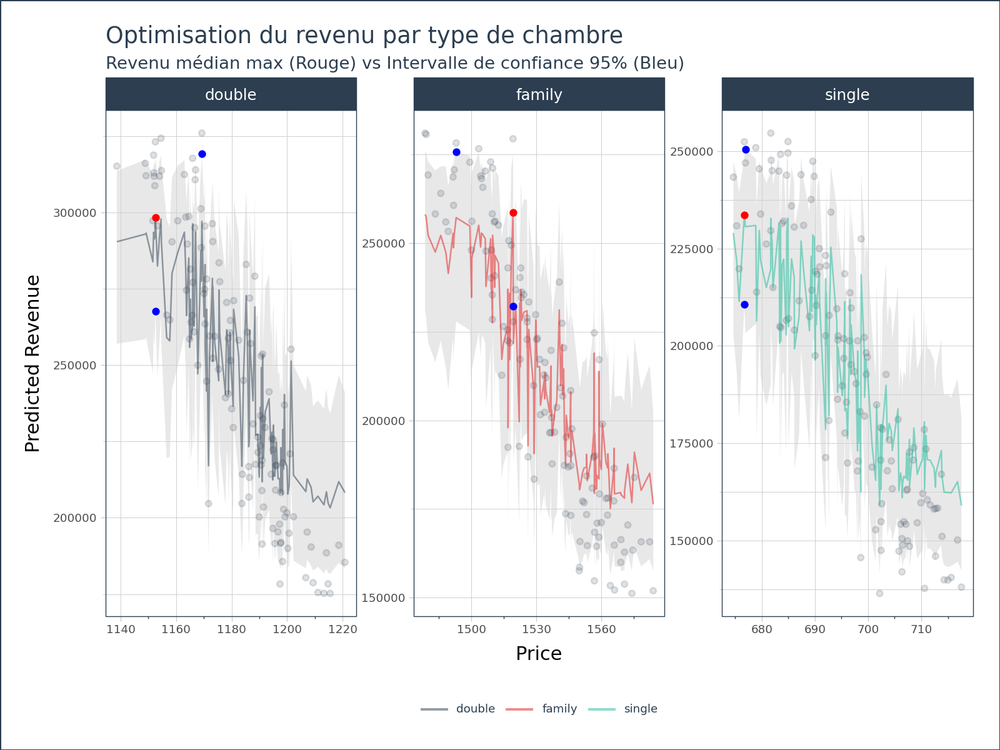

In [19]:

(
    ggplot(
        data=data_filtered,
        mapping=aes(x='paid price', y='rev_0.5', color='type de chambre', group='type de chambre')
    ) + \
    geom_ribbon(aes(ymax='rev_0.975', ymin='rev_0.025'),
                fill="#d3d3d3", color="#FF000000", alpha=0.5, show_legend=False) + \
    geom_point(aes(y='rev par type de chambre'), alpha=0.15, color="#2C3E50")+
    \
    geom_line(aes(y='rev_0.5'), alpha=0.5) + \
    geom_point(data=best_50, color='red') + \
    geom_point(data=best_975, mapping=aes(y='rev_0.975'), color='blue') + \
    geom_point(data=best_025, mapping=aes(y='rev_0.025'), color='blue') + \
    facet_wrap('type de chambre', scales='free') + \
    labs(
        title="Optimisation du revenu par type de chambre",
        subtitle="Revenu médian max (Rouge) vs Intervalle de confiance 95% (Bleu)",
        x="Price",
        y="Predicted Revenue"
    ) + \
    scale_color_manual(values = list(tk.palette_timetk().values())) + \
    tk.theme_timetk(width=800, height=600)
)